In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from torch.utils.data.dataset import random_split
import os
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T

from PIL import Image
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision.models as models
from torch.utils.data import DataLoader
import torchvision.transforms as T

In [2]:
df=pd.read_csv("/kaggle/input/dataframe/dataframe.csv")
df

,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...
...,...,...
40450,997722733_0cb5439472.jpg,A man in a pink shirt climbs a rock face
40451,997722733_0cb5439472.jpg,A man is rock climbing high in the air .
40452,997722733_0cb5439472.jpg,A person in a red shirt climbing up a rock fac...
40453,997722733_0cb5439472.jpg,A rock climber in a red shirt .


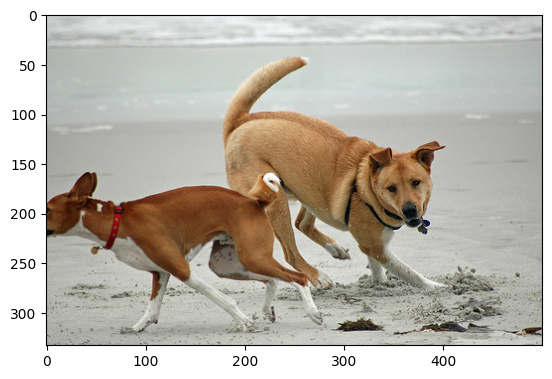

Caption: Two different breeds of brown and white dogs play on the beach .
Caption: Two dogs are making a turn on a soft sand beach .
Caption: Two dogs playing in the sand at the beach .
Caption: Two dogs playing together on a beach .
Caption: Two large tan dogs play along a sandy beach .


In [3]:
data_idx = 100
image_path = "/kaggle/input/flickr8k/Images/"+df.iloc[data_idx,0]
img=mpimg.imread(image_path)
plt.imshow(img)
plt.show()

for i in range(data_idx,data_idx+5):
    print("Caption:",df.iloc[i,1])

In [4]:
spacy_eng = spacy.load("en_core_web_sm")

text = "We are going to Udaipur"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['we', 'are', 'going', 'to', 'udaipur']

In [5]:
class Vocabulary:
    def __init__(self, freq_threshold):
        # specifying for special tokens
        self.itos = {0: "<PAD>", 1: "<SOS>", 2: "<EOS>", 3: "<UNK>"}

        # String to int tokens, its reverse dict self.itos
        self.stoi = {v: k for k, v in self.itos.items()}

        self.freq_threshold = freq_threshold

    def __len__(self):
        #total unique tokens
        return len(self.itos)

    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]

    def build_vocab(self, sentence_list):
        #assigning integer values to unique tokens which pass the freq threshold
        frequencies = Counter()
        idx = 4 # 0-3 assigned to special tokens
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1

    def numericalize(self, text):
        #For each word in the text, corresponding index token for that word from the vocab built as a list
        tokenized_text = self.tokenize(text)
        return [self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text]


In [6]:
v = Vocabulary(freq_threshold=1)

v.build_vocab(["We are going to Udaipur and we will come back day after tomorrow"])
print("vocabulary is ",v.stoi)
print("list of sentence is",v.numericalize("We are going to Udaipur "))

vocabulary is  {'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, 'we': 4, 'are': 5, 'going': 6, 'to': 7, 'udaipur': 8, 'and': 9, 'will': 10, 'come': 11, 'back': 12, 'day': 13, 'after': 14, 'tomorrow': 15}
list of sentence is [4, 5, 6, 7, 8]


In [7]:
class FlickrDataset(Dataset):
    
    def __init__(self,root_dir,image_captions_file,transform=None,freq_threshold=4):
        self.root_dir = root_dir
        self.df = pd.read_csv(image_captions_file)
        self.transform = transform
        
        #Get image and caption colum from the dataframe
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        #Initialize vocabulary and build vocab
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
        
    
    def __len__(self):
        return len(self.df)
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        #apply the transfromation to the image
        if self.transform is not None:
            img = self.transform(img)
        
        #numericalize the caption text
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec)

In [8]:
transforms = T.Compose([
    T.Resize((224,224)),
    T.ToTensor()
])

In [9]:
def show_image(inp, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001) 

In [10]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

print('Using device:', device)

Using device: cuda


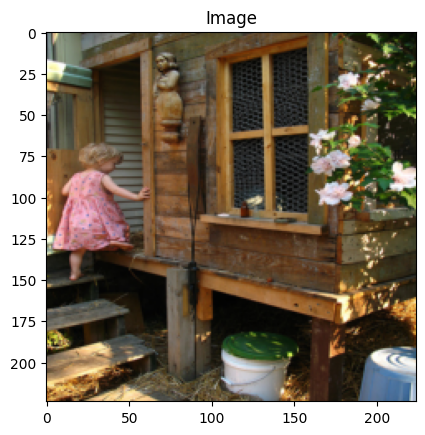

Token: tensor([  1,   4,  30,   8,   4, 250, 197,  18,  28,  80,   4, 357,  13, 863,
          8,  27,   3, 276,   5,   2])
Sentence:
['<SOS>', 'a', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', '<UNK>', 'way', '.', '<EOS>']
A child in a pink dress is climbing up a set of stairs in an entry way .


In [11]:
dataset =  FlickrDataset(
    root_dir = "/kaggle/input/flickr8k/Images/",
    image_captions_file = "/kaggle/input/flickr8k/captions.txt",
    transform=transforms
)
img, caps = dataset[0]
show_image(img,"Image")
print("Token:",caps)
print("Sentence:")
print([dataset.vocab.itos[token] for token in caps.tolist()])

first_row_caption = df.loc[0, "caption"]
print(first_row_caption)

In [12]:
class CapsCollate:
    
    # Collate to apply the padding to the captions with dataloader
   
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
    
    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        imgs = torch.cat(imgs,dim=0)
        
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

In [13]:
BATCH_SIZE = 64
NUM_WORKER = 1

#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]

# data_loader = DataLoader(
#     dataset=dataset,
#     batch_size=BATCH_SIZE,
#     num_workers=NUM_WORKER,
#     shuffle=True,
#     collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True)
# )

In [14]:
train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])


In [15]:
print(type(train_dataset))

<class 'torch.utils.data.dataset.Subset'>


In [16]:
subset_indices = train_dataset.indices

original_dataset = train_dataset.dataset

train_df = original_dataset.df.iloc[subset_indices]
train_df

,image,caption
5098,210625425_fb1ef5d23b.jpg,The car sinks up to the tops of its wheels in ...
10663,2516317118_10ae66b87a.jpg,The child is sticking paper letters to a woode...
38693,556568556_bc5124dc8e.jpg,A little kid plays on the swing at the playgro...
25496,3331190056_09f4ca9fd2.jpg,"Two boys , one black and one white , standing ..."
10882,2528521798_fb689eba8d.jpg,A white race car makes a splash through a wet ...
...,...,...
8275,2371809188_b805497cba.jpg,A boy climbs an indoor rock climbing wall .
28418,3444684583_6656e38088.jpg,"A man performs a trick on his mini-race car , ..."
24033,3265162450_5b4e3c5f1b.jpg,Three dogs walk together across a snowy field .
1323,1301140633_046e4e8010.jpg,Blond child with dirty face holding yellow bot...


In [17]:
subset_indices2 = val_dataset.indices
val_df = original_dataset.df.iloc[subset_indices2]
val_df

,image,caption
14378,2761599088_8b39cc5f41.jpg,The big dog has a green toy in its mouth .
37591,497791037_93499238d8.jpg,A boy jumps off a swing on the swing set when ...
28487,3448490813_f9623e864d.jpg,A child climbs to the top of a slide .
26541,3368819708_0bfa0808f8.jpg,a snowboarder gets air off a jump .
30347,3523559027_a65619a34b.jpg,Marching bands in formation on a field .
...,...,...
29693,3497234632_6ec740fc1e.jpg,Several men around an indoor basketball hoop .
3142,160566014_59528ff897.jpg,A man and a woman sit on a car and face the op...
29601,3492383096_5bbc08f0da.jpg,Three dogs are playing together on the sandy s...
29376,348380010_33bb0599ef.jpg,"A brown dog lies on its back in the grass , ho..."


In [18]:
subset_indices3 = test_dataset.indices
test_df = original_dataset.df.iloc[subset_indices3]
test_df

,image,caption
20895,3136674757_57406c305c.jpg,An older man in a tank top and a younger girl ...
22059,3187492926_8aa85f80c6.jpg,A person is diving into clear blue water .
31823,3580741947_cc64a83648.jpg,Three women in dress suits walk by a building .
18081,2991994607_06f24ec7a6.jpg,Man in a police costume next to a man in a zom...
24214,3273091032_98f724b36b.jpg,The squirrel sits straight up in the grass .
...,...,...
28988,3468130925_2b1489d19a.jpg,Two men are playing rugby .
19957,3091962081_194f2f3bd4.jpg,A salt-and-pepper-haired man with beard and gl...
3456,1752454466_723790dbd6.jpg,A brown and white dog is running down a ramp .
4393,2057305043_952b8dc82c.jpg,Someone with a purple parachute has jumped off...


In [19]:
BATCH_SIZE = 64
NUM_WORKERS = 1

pad_idx = dataset.vocab.stoi["<PAD>"]

train_loader = DataLoader(
    dataset=train_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=True,
    collate_fn=CapsCollate(pad_idx=pad_idx, batch_first=True)
)

val_loader = DataLoader(
    dataset=val_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=False,
    collate_fn=CapsCollate(pad_idx=pad_idx, batch_first=True)
)

test_loader = DataLoader(
    dataset=test_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=False,
    collate_fn=CapsCollate(pad_idx=pad_idx, batch_first=True)
)


In [20]:
vocab_size = len(dataset.vocab)
print(vocab_size)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

3432


device(type='cuda', index=0)

In [21]:
class EncoderCNN(nn.Module):
    def __init__(self):
        super(EncoderCNN, self).__init__()
        resnet = models.resnet50(pretrained=True)
        for param in resnet.parameters():
            param.requires_grad_(False)
        
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)
        

    def forward(self, images):
        features = self.resnet(images)                                    #(batch_size,2048,7,7)
        features = features.permute(0, 2, 3, 1)                           #(batch_size,7,7,2048)
        features = features.view(features.size(0), -1, features.size(-1)) #(batch_size,49,2048)
        return features

In [22]:
class Attention(nn.Module):
    def __init__(self, encoder_dim,decoder_dim,attention_dim):
        super(Attention, self).__init__()
        
        self.attention_dim = attention_dim
        
        self.W = nn.Linear(decoder_dim,attention_dim)
        self.U = nn.Linear(encoder_dim,attention_dim)
        
        self.A = nn.Linear(attention_dim,1)
        
        
        
        
    def forward(self, features, hidden_state):
        u_hs = self.U(features)    
        w_ah = self.W(hidden_state) 
        
        combined_states = torch.tanh(u_hs + w_ah.unsqueeze(1))
        attention_scores = self.A(combined_states)        
        attention_scores = attention_scores.squeeze(2)    
        
        
        alpha = F.softmax(attention_scores,dim=1)         
        
        attention_weights = features * alpha.unsqueeze(2)  
        attention_weights = attention_weights.sum(dim=1)   
        
        return alpha,attention_weights
        

In [23]:
class DecoderRNN(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        
        #save the model param
        self.vocab_size = vocab_size
        self.attention_dim = attention_dim
        self.decoder_dim = decoder_dim
        
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.attention = Attention(encoder_dim,decoder_dim,attention_dim)
        
        
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  
        self.lstm_cell = nn.LSTMCell(embed_size+encoder_dim,decoder_dim,bias=True)
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)
        
        
        self.fcn = nn.Linear(decoder_dim,vocab_size)
        self.drop = nn.Dropout(drop_prob)
    def forward(self, features, captions):
        
        #vectorize the caption
        embeds = self.embedding(captions)
        
        # Initialize LSTM state
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
        #get the seq length to iterate
        seq_length = len(captions[0])-1 #Exclude the last one
        batch_size = captions.size(0)
        num_features = features.size(1)
        
        preds = torch.zeros(batch_size, seq_length, self.vocab_size).to(device)
        alphas = torch.zeros(batch_size, seq_length,num_features).to(device)
                
        for s in range(seq_length):
            alpha,context = self.attention(features, h)
            lstm_input = torch.cat((embeds[:, s], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            
            preds[:,s] = output
            alphas[:,s] = alpha  
        
        
        return preds, alphas
    def generate_caption(self,features,max_len=20,vocab=None):
       
        
        batch_size = features.size(0)
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
        alphas = []
        
        #starting input
        word = torch.tensor(vocab.stoi['<SOS>']).view(1,-1).to(device)
        embeds = self.embedding(word)

        
        captions = []
        
        for i in range(max_len):
            alpha,context = self.attention(features, h)
            alphas.append(alpha.cpu().detach().numpy())
            
        
            lstm_input = torch.cat((embeds[:, 0], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            embeds = self.embedding(predicted_word_idx.unsqueeze(0))
        return [vocab.itos[idx] for idx in captions],alphas
    
    
    def init_hidden_state(self, encoder_out):
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        return h, c
    
        

In [24]:
class EncoderDecoder(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        self.encoder = EncoderCNN()
        self.decoder = DecoderRNN(
            embed_size=embed_size,
            vocab_size = len(dataset.vocab),
            attention_dim=attention_dim,
            encoder_dim=encoder_dim,
            decoder_dim=decoder_dim
        )
        
    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs

In [25]:
import torch

from transformers import CLIPProcessor, CLIPModel
from PIL import Image
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
from tqdm import tqdm




In [26]:
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
clip_model.to(device)
clip_model.eval()


2024-04-12 13:43:45.318893: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-12 13:43:45.318988: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-12 13:43:45.447470: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

/opt/conda/lib/python3.10/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


CLIPModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 512)
      (position_embedding): Embedding(77, 512)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=512, out_features=512, bias=True)
            (v_proj): Linear(in_features=512, out_features=512, bias=True)
            (q_proj): Linear(in_features=512, out_features=512, bias=True)
            (out_proj): Linear(in_features=512, out_features=512, bias=True)
          )
          (layer_norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=512, out_features=2048, bias=True)
            (fc2): Linear(in_features=2048, out_features=512, bias=True)
          )
          (layer_norm2): LayerNorm((512,), eps=1e-05,

In [27]:
print(train_dataset)

In [28]:

def encode_text(text):
    inputs = clip_processor(text=text, return_tensors="pt")
    input_ids = inputs["input_ids"].to(clip_model.device)  # Move to the same device as clip_model
    attention_mask = inputs["attention_mask"].to(clip_model.device)  # Move to the same device as clip_model
    text_features = clip_model.get_text_features(input_ids=input_ids, attention_mask=attention_mask)
    return text_features.cpu().detach().numpy()
text="My name is Alisa"
encoding=encode_text(text)
print(type(encoding))






<class 'numpy.ndarray'>


In [29]:
embed_size=300
vocab_size = len(dataset.vocab)
attention_dim=256
encoder_dim=2048
decoder_dim=512
learning_rate = 3e-4

In [30]:
model = EncoderDecoder(
    embed_size=300,
    vocab_size = len(dataset.vocab),
    attention_dim=256,
    encoder_dim=2048,
    decoder_dim=512
).to(device)

# criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 163MB/s] 


In [31]:
def save_model(model,num_epochs):
    model_state = {
        'num_epochs':num_epochs,
        'embed_size':embed_size,
        'vocab_size':len(dataset.vocab),
        'attention_dim':attention_dim,
        'encoder_dim':encoder_dim,
        'decoder_dim':decoder_dim,
        'state_dict':model.state_dict()
    }

    torch.save(model_state,'attention_model_state.pth')

In [32]:
dataset =  FlickrDataset(
    root_dir = "/kaggle/input/flickr8k/Images/",
    image_captions_file = "/kaggle/input/flickr8k/captions.txt",
    transform=transforms
)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 1:  23%|██▎       | 114/506 [01:09<03:40,  1.78batch/s, loss=4.49]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


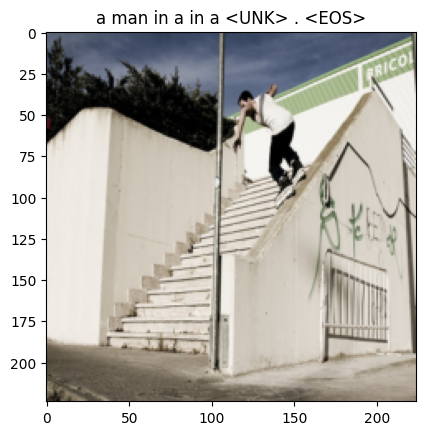

Epoch 1:  43%|████▎     | 220/506 [02:04<02:15,  2.12batch/s, loss=4.08]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


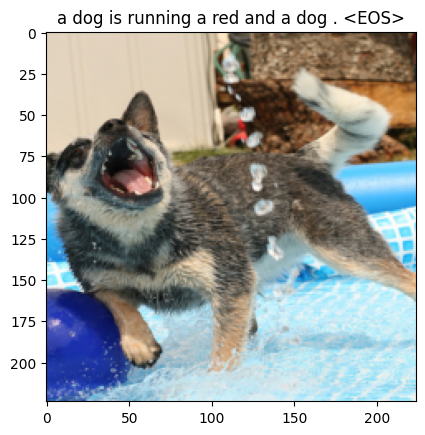

Epoch 1:  64%|██████▍   | 324/506 [02:53<01:24,  2.16batch/s, loss=3.67]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


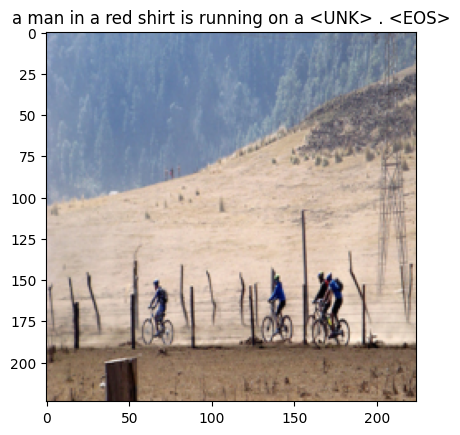

Epoch 1:  85%|████████▍ | 428/506 [03:38<00:32,  2.40batch/s, loss=3.49]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


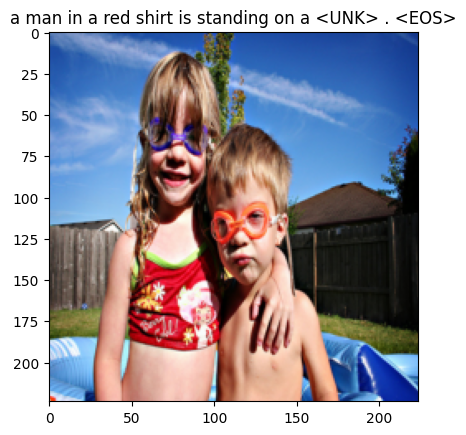

Epoch 1: 532batch [04:21,  2.73batch/s, loss=3.47]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


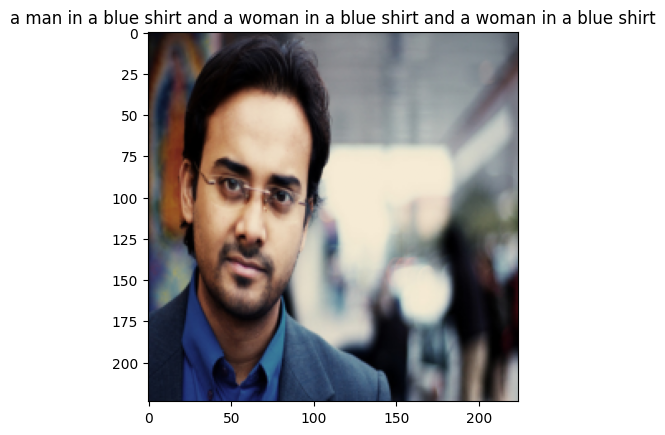

Epoch 1: 100%|██████████| 506/506 [04:24<00:00,  1.91batch/s, loss=3.54]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 2:  23%|██▎       | 114/506 [00:42<02:34,  2.53batch/s, loss=3.41]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


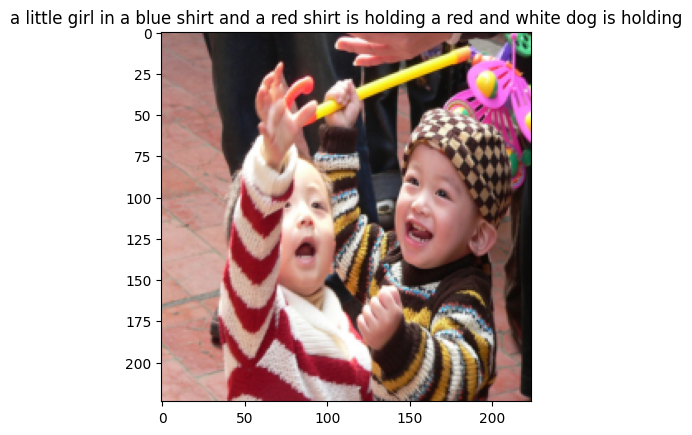

Epoch 2:  43%|████▎     | 220/506 [01:25<01:58,  2.41batch/s, loss=3.06]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


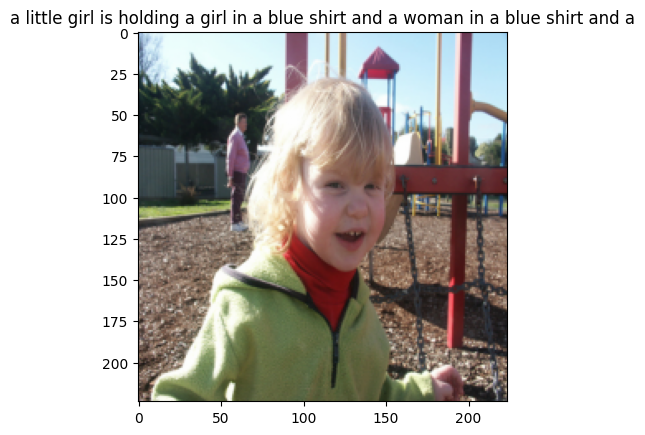

Epoch 2:  64%|██████▍   | 324/506 [02:09<01:13,  2.46batch/s, loss=3.32]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


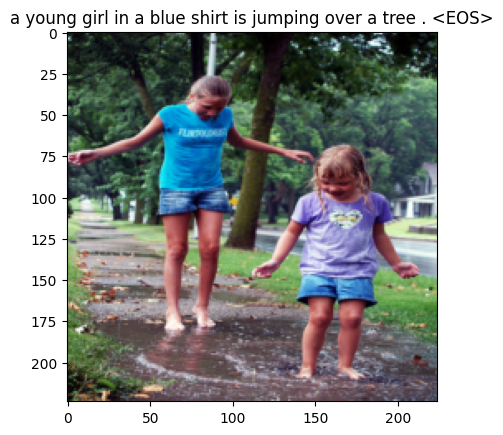

Epoch 2:  85%|████████▍ | 428/506 [02:54<00:32,  2.43batch/s, loss=2.98]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


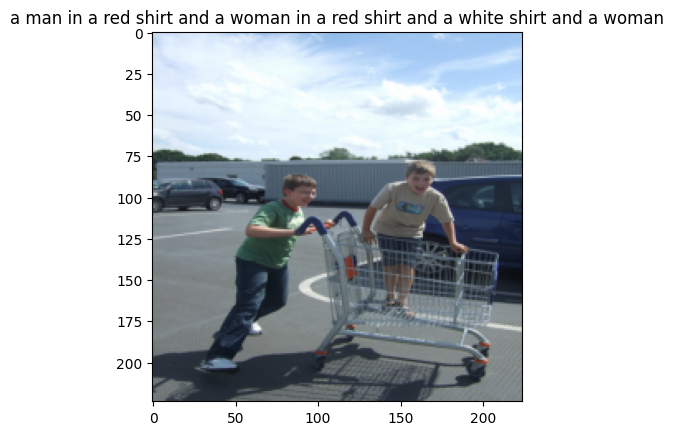

Epoch 2: 532batch [03:38,  2.56batch/s, loss=3.25]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


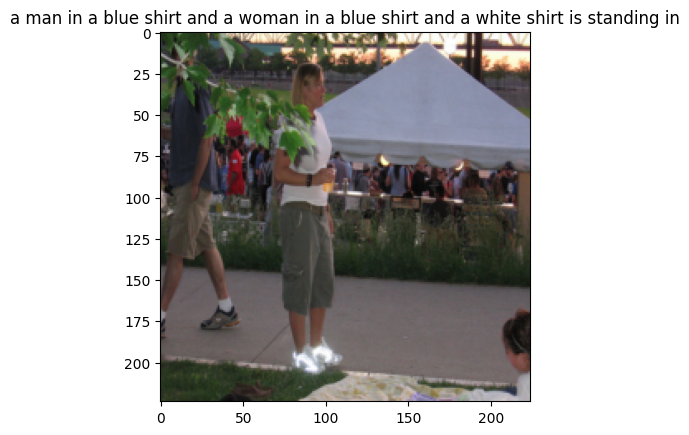

Epoch 2: 100%|██████████| 506/506 [03:41<00:00,  2.29batch/s, loss=3.1]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 3:  23%|██▎       | 114/506 [00:41<02:41,  2.43batch/s, loss=3.04]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


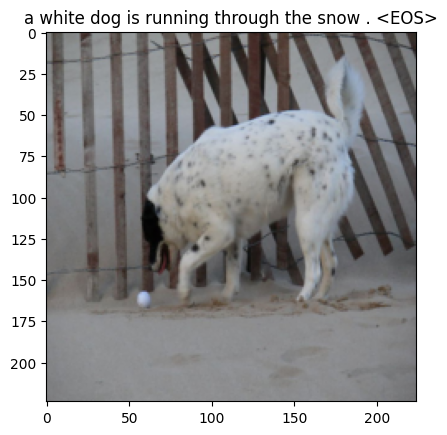

Epoch 3:  43%|████▎     | 220/506 [01:24<02:05,  2.28batch/s, loss=2.8] huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


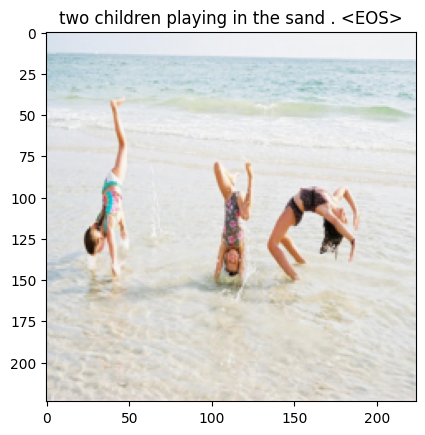

Epoch 3:  64%|██████▍   | 324/506 [02:07<01:13,  2.48batch/s, loss=3.03]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


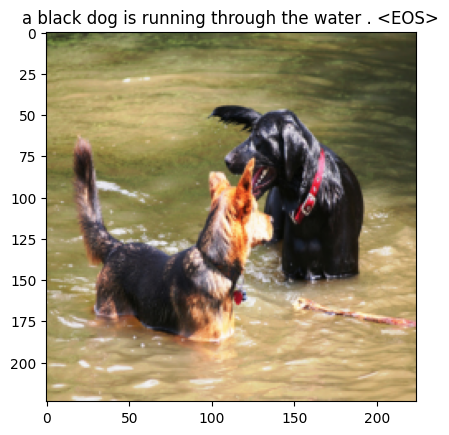

Epoch 3:  85%|████████▍ | 428/506 [02:49<00:32,  2.41batch/s, loss=3.03]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


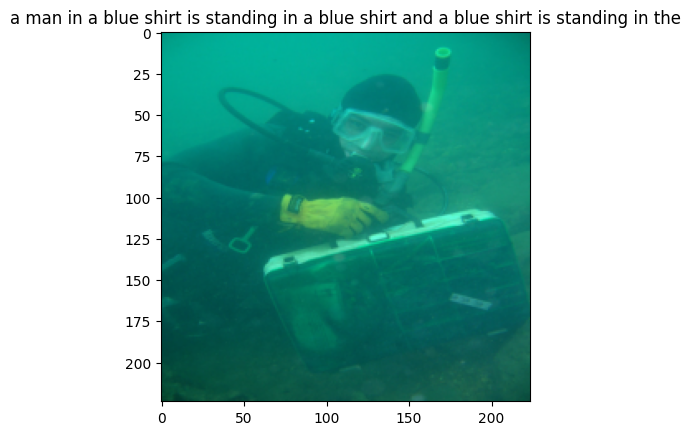

Epoch 3: 532batch [03:32,  2.87batch/s, loss=2.98]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


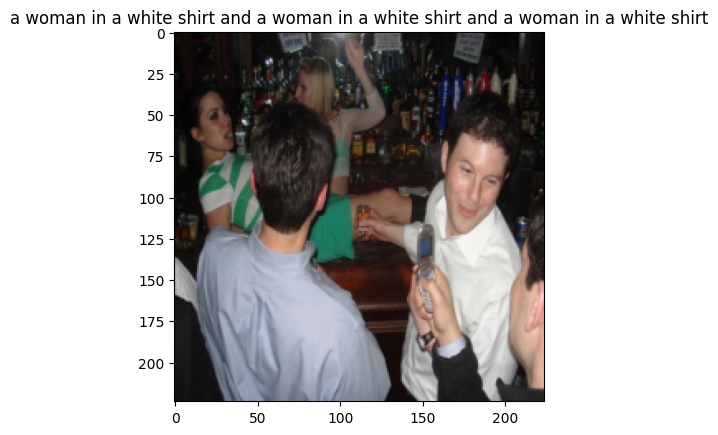

Epoch 3: 100%|██████████| 506/506 [03:35<00:00,  2.35batch/s, loss=2.98]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 4:  23%|██▎       | 114/506 [00:41<02:33,  2.55batch/s, loss=2.88]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


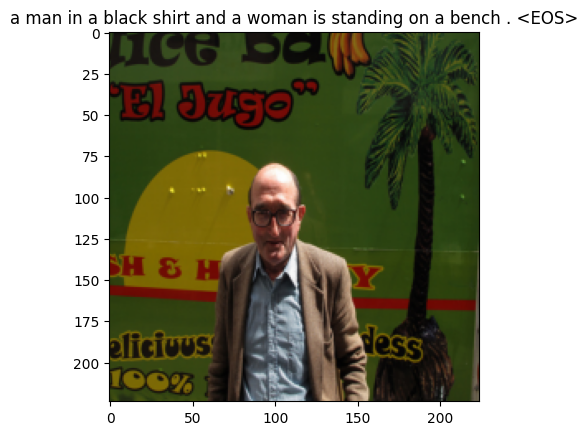

Epoch 4:  43%|████▎     | 220/506 [01:24<01:53,  2.51batch/s, loss=2.84]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


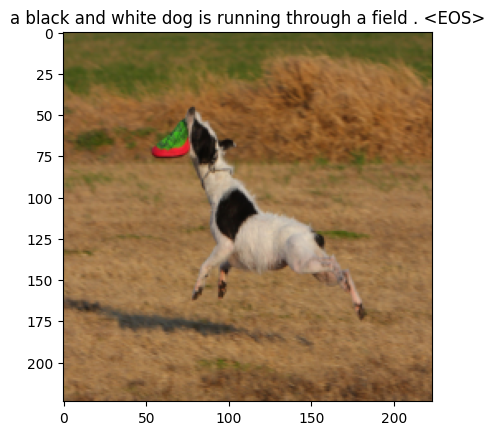

Epoch 4:  64%|██████▍   | 324/506 [02:06<01:13,  2.48batch/s, loss=2.55]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


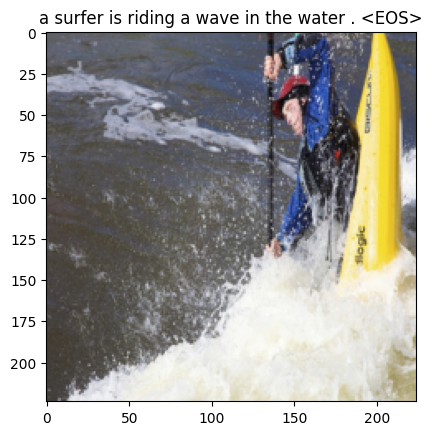

Epoch 4:  85%|████████▍ | 428/506 [02:49<00:33,  2.30batch/s, loss=2.67]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


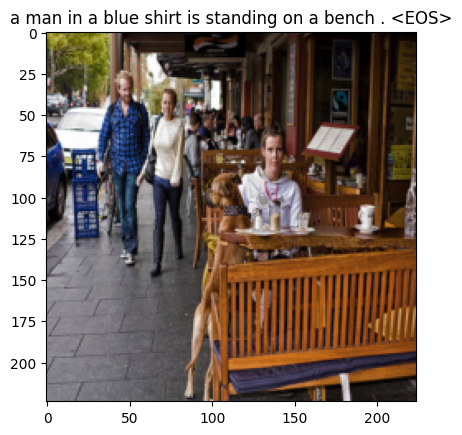

Epoch 4: 532batch [03:32,  2.76batch/s, loss=2.65]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


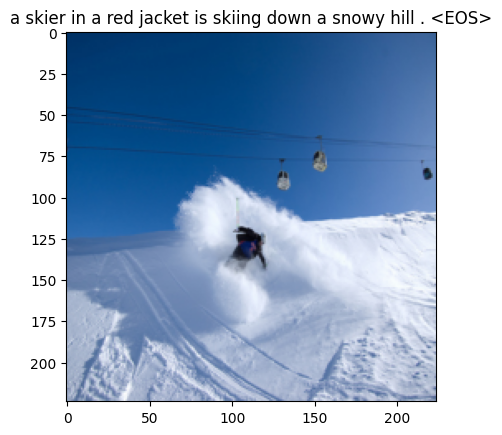

Epoch 4: 100%|██████████| 506/506 [03:35<00:00,  2.35batch/s, loss=2.74]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 5:  23%|██▎       | 114/506 [00:42<02:38,  2.48batch/s, loss=2.83]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


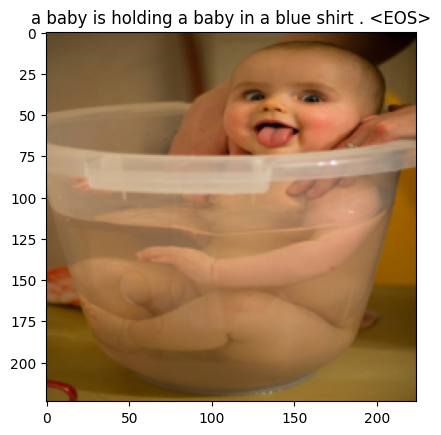

Epoch 5:  43%|████▎     | 220/506 [01:24<01:52,  2.55batch/s, loss=2.6] huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


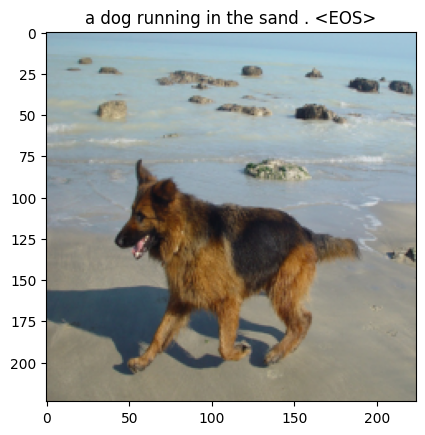

Epoch 5:  64%|██████▍   | 324/506 [02:06<01:10,  2.57batch/s, loss=2.7] huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


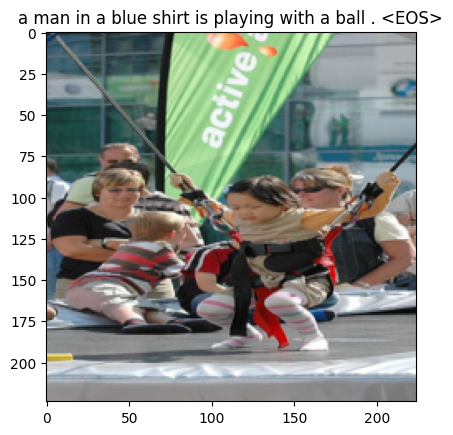

Epoch 5:  85%|████████▍ | 428/506 [02:50<00:30,  2.56batch/s, loss=2.56]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


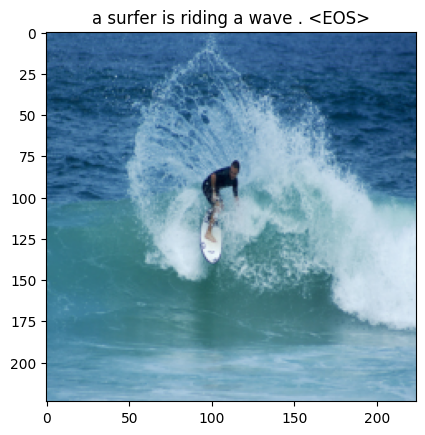

Epoch 5: 532batch [03:32,  2.74batch/s, loss=2.48]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


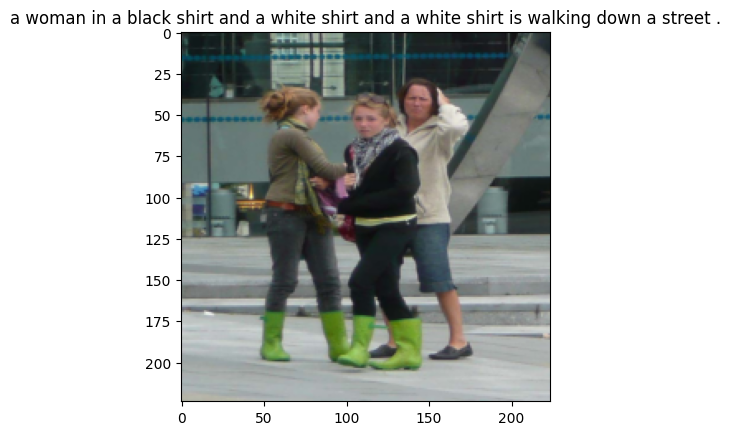

Epoch 5: 100%|██████████| 506/506 [03:35<00:00,  2.35batch/s, loss=2.64]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 6:  23%|██▎       | 114/506 [00:43<02:46,  2.36batch/s, loss=2.65]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


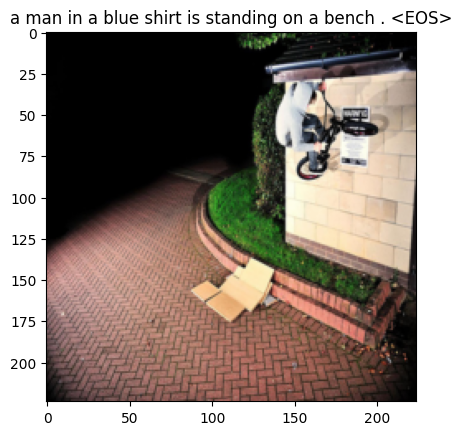

Epoch 6:  43%|████▎     | 220/506 [01:26<01:53,  2.51batch/s, loss=2.65]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


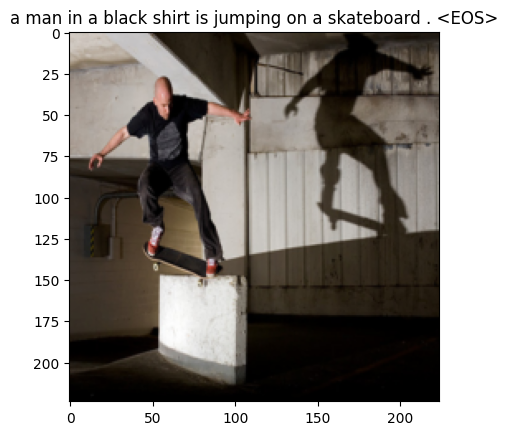

Epoch 6:  64%|██████▍   | 324/506 [02:09<01:16,  2.38batch/s, loss=2.75]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


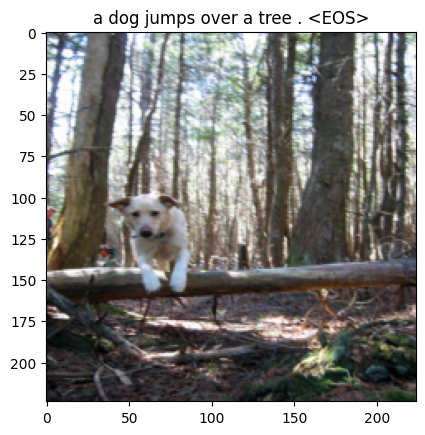

Epoch 6:  85%|████████▍ | 428/506 [02:52<00:33,  2.34batch/s, loss=2.65]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


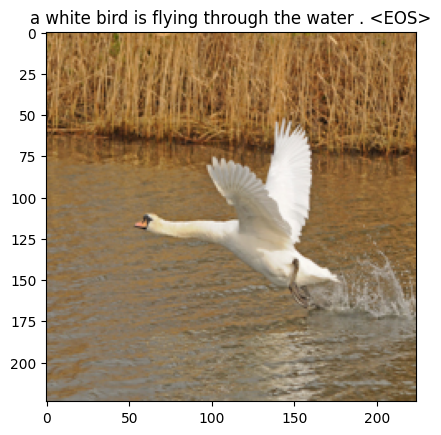

Epoch 6: 532batch [03:34,  2.85batch/s, loss=2.79]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


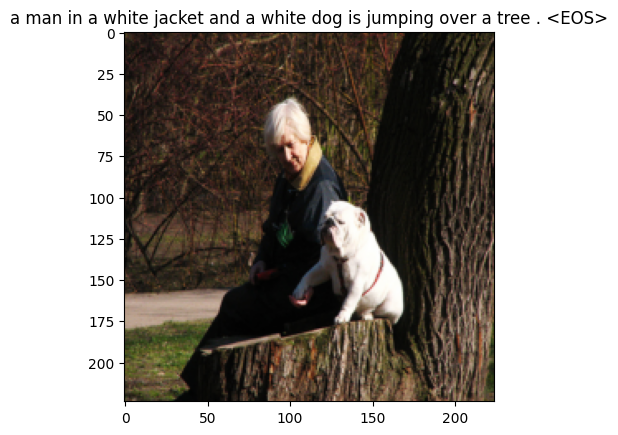

Epoch 6: 100%|██████████| 506/506 [03:37<00:00,  2.33batch/s, loss=2.49]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 7:  23%|██▎       | 114/506 [00:42<02:33,  2.55batch/s, loss=2.38]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


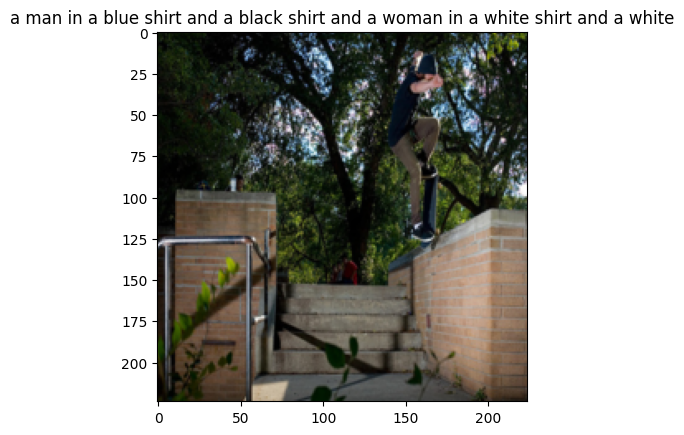

Epoch 7:  43%|████▎     | 220/506 [01:26<02:03,  2.32batch/s, loss=2.63]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


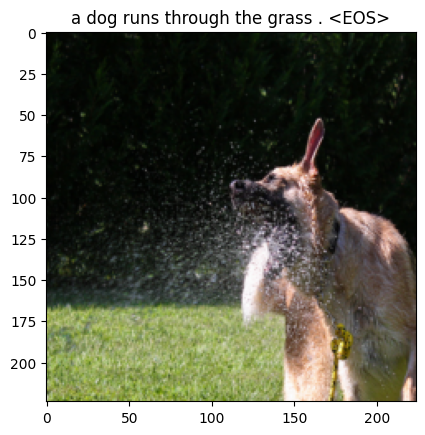

Epoch 7:  64%|██████▍   | 324/506 [02:10<01:14,  2.43batch/s, loss=2.48]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


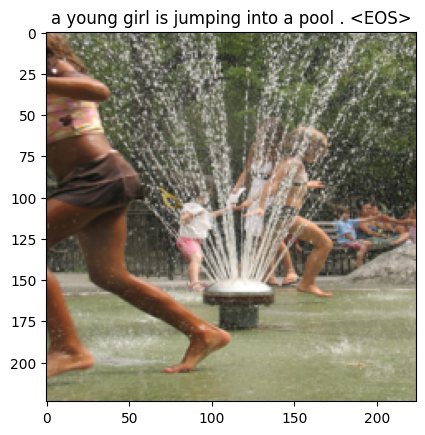

Epoch 7:  85%|████████▍ | 428/506 [02:55<00:32,  2.38batch/s, loss=2.52]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


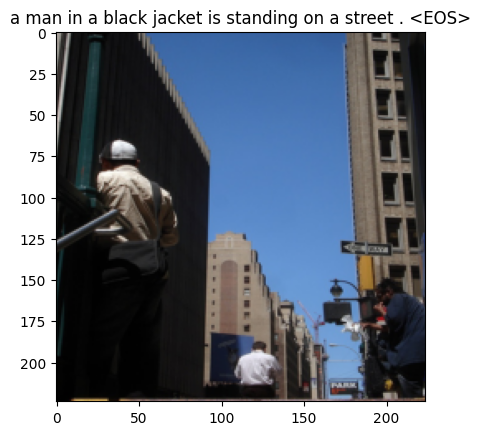

Epoch 7: 532batch [03:38,  2.61batch/s, loss=2.42]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


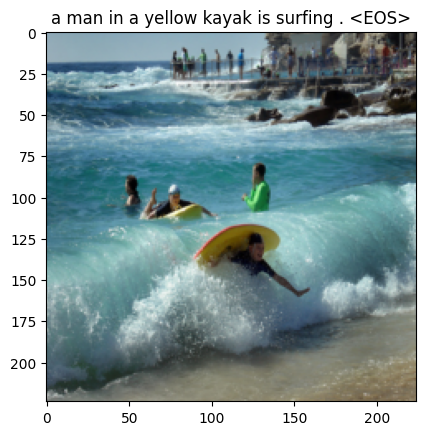

Epoch 7: 100%|██████████| 506/506 [03:41<00:00,  2.28batch/s, loss=2.29]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 8:  23%|██▎       | 114/506 [00:42<02:45,  2.37batch/s, loss=2.39]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


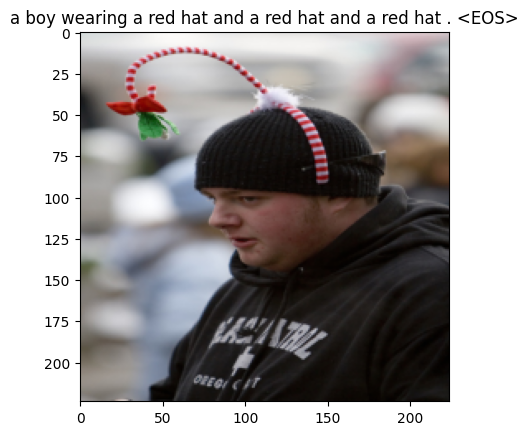

Epoch 8:  43%|████▎     | 220/506 [01:26<01:56,  2.46batch/s, loss=2.43]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


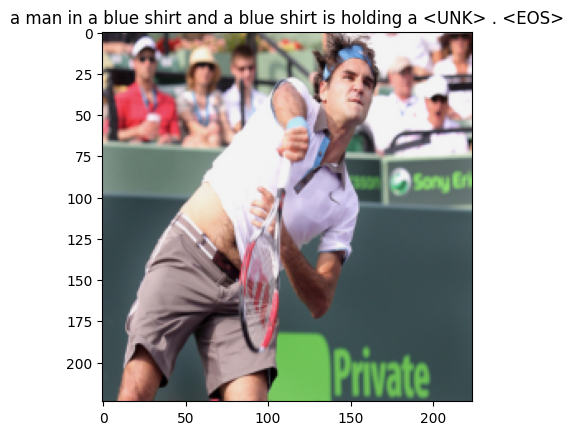

Epoch 8:  64%|██████▍   | 324/506 [02:12<01:23,  2.17batch/s, loss=2.31]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


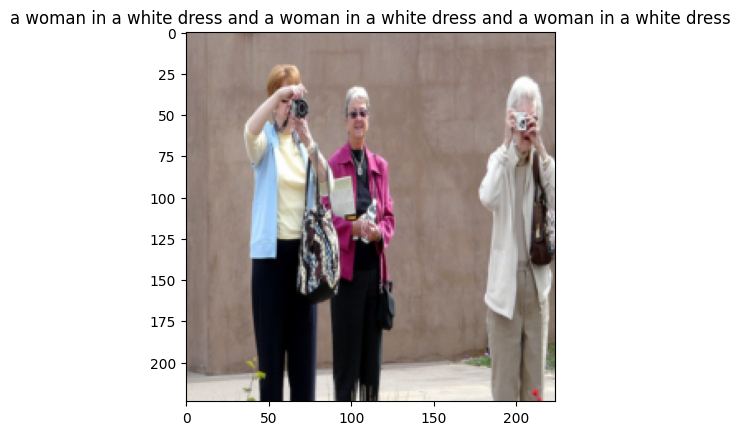

Epoch 8:  85%|████████▍ | 428/506 [02:59<00:34,  2.24batch/s, loss=2.67]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


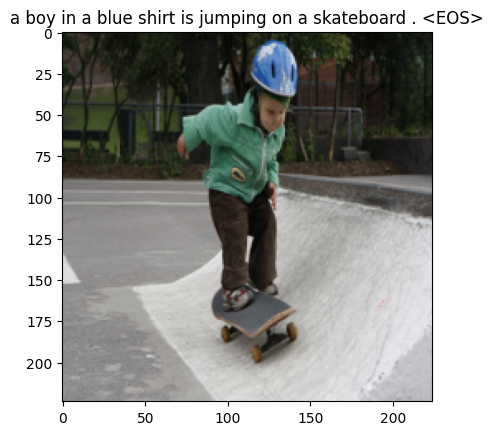

Epoch 8: 532batch [03:44,  2.55batch/s, loss=2.39]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


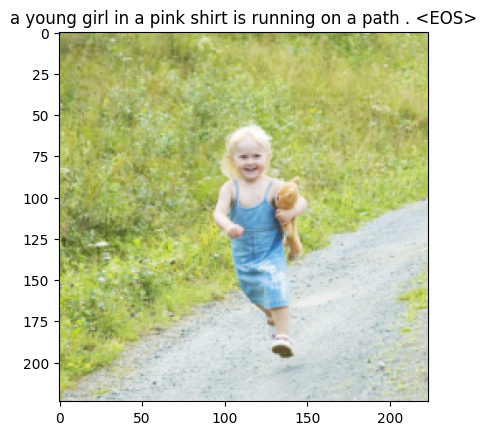

Epoch 8: 100%|██████████| 506/506 [03:48<00:00,  2.22batch/s, loss=2.51]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 9:  23%|██▎       | 114/506 [00:44<02:58,  2.19batch/s, loss=2.19]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


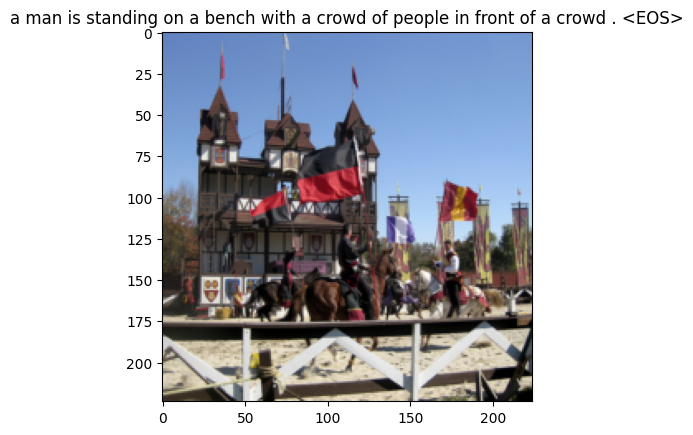

Epoch 9:  43%|████▎     | 220/506 [01:29<02:10,  2.20batch/s, loss=2.41]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


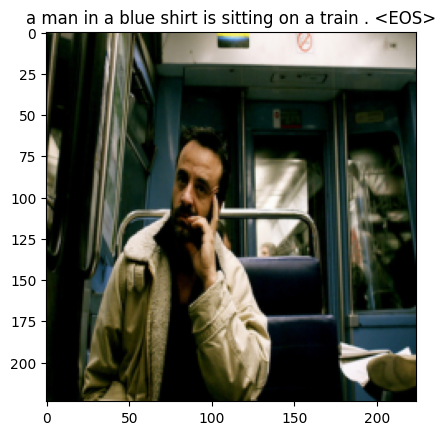

Epoch 9:  64%|██████▍   | 324/506 [02:14<01:21,  2.23batch/s, loss=2.41]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


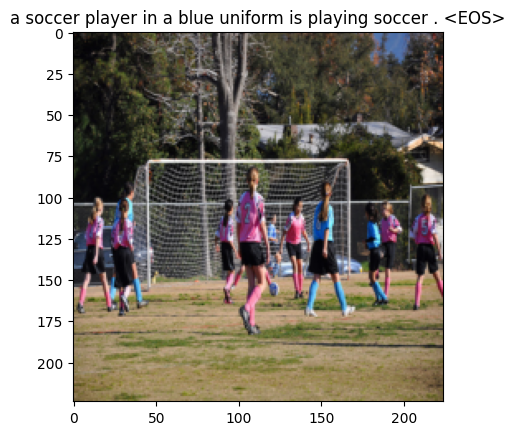

Epoch 9:  85%|████████▍ | 428/506 [02:59<00:33,  2.33batch/s, loss=2.32]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


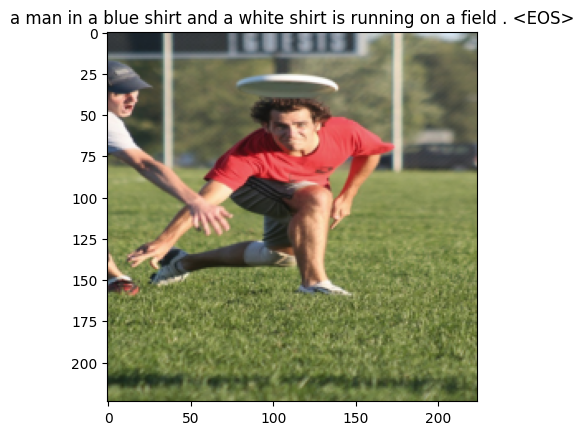

Epoch 9: 532batch [03:42,  2.58batch/s, loss=2.36]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


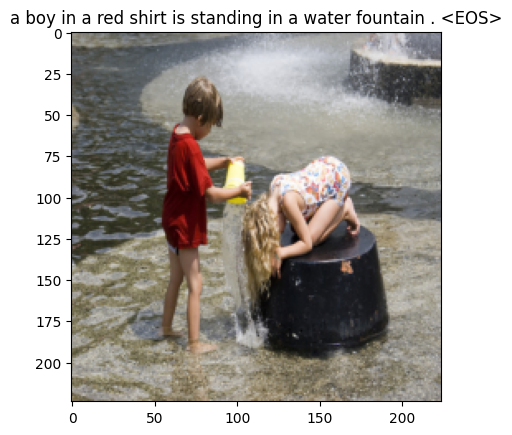

Epoch 9: 100%|██████████| 506/506 [03:45<00:00,  2.24batch/s, loss=2.2]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Epoch 10:  23%|██▎       | 114/506 [00:43<02:36,  2.51batch/s, loss=2.33]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


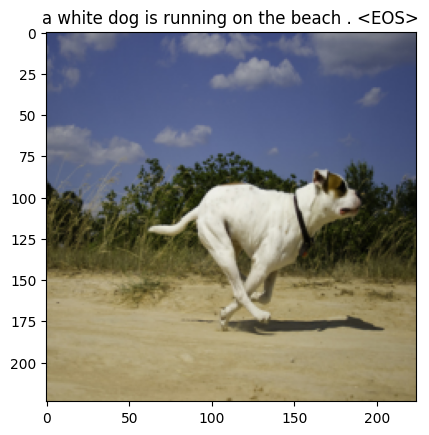

Epoch 10:  43%|████▎     | 220/506 [01:28<01:58,  2.42batch/s, loss=2.2] huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


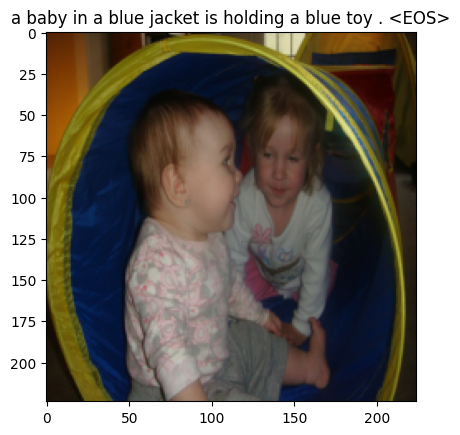

Epoch 10:  64%|██████▍   | 324/506 [02:12<01:20,  2.25batch/s, loss=2.4] huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


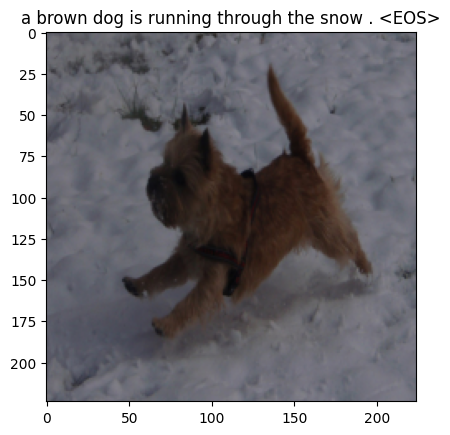

Epoch 10:  85%|████████▍ | 428/506 [02:56<00:33,  2.31batch/s, loss=2.26]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


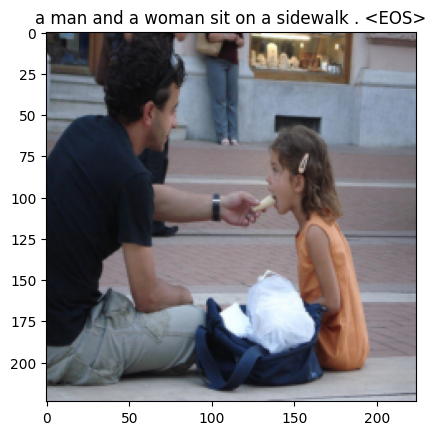

Epoch 10: 532batch [03:40,  2.75batch/s, loss=2.39]                      huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


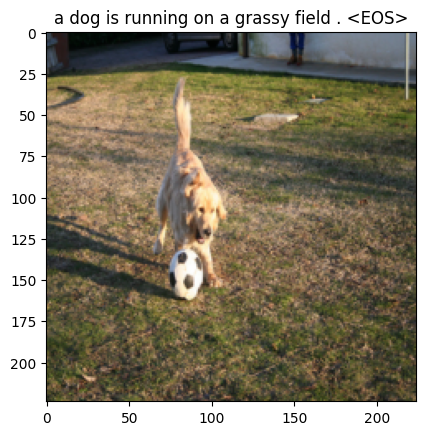

Epoch 10: 100%|██████████| 506/506 [03:43<00:00,  2.27batch/s, loss=2.4]


In [33]:
import torch
import numpy as np
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm

num_epochs = 10
print_every = 100
criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
train_losses = []  
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

for epoch in range(1, num_epochs+1):
    epoch_losses = []  
    total_batches = len(train_loader)

    # Create tqdm progress bar
    progress_bar = tqdm(enumerate(train_loader), total=total_batches, desc=f'Epoch {epoch}', unit="batch")

    for idx, (image, captions) in progress_bar:
        image, captions = image.to(device), captions.to(device)

      
        optimizer.zero_grad()

        outputs, attentions = model(image, captions)

       
        targets = captions[:, 1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))

    
        loss.backward()

        optimizer.step()

 
        epoch_losses.append(loss.item())

        progress_bar.set_postfix(loss=loss.item())
        progress_bar.update()

        if (idx+1) % print_every == 0:
            model.eval()
            with torch.no_grad():
                dataiter = iter(train_loader)
                img, _ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                caps, alphas = model.decoder.generate_caption(features, vocab=dataset.vocab)
                caption = ' '.join(caps)
                show_image(img[0], title=caption)

            model.train()


    epoch_loss_avg = sum(epoch_losses) / len(epoch_losses)
    train_losses.append(epoch_loss_avg)

    save_model(model, epoch)

    progress_bar.close()

np.savetxt('train_losses.txt', train_losses)

In [34]:
import torch
import numpy as np
import pandas as pd
from tqdm import tqdm

generated_captions = []

model.eval()

total_test_batches = len(test_loader)
test_progress_bar = tqdm(enumerate(test_loader), total=total_test_batches, desc='Testing', unit="batch")

with torch.no_grad():
    for idx, (image, _) in test_progress_bar:
        image = image.to(device)

        features = model.encoder(image)

        for i in range(image.shape[0]):
            caps, _ = model.decoder.generate_caption(features[i].unsqueeze(0), vocab=dataset.vocab)
            generated_captions.append({
                'Generated Caption': ' '.join(caps)
            })

test_progress_bar.close()

test_df_gen = pd.DataFrame(generated_captions)
test_df_gen

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Testing: 100%|██████████| 64/64 [00:46<00:00,  1.38batch/s]


,Generated Caption
0,a man with a blue shirt and a woman in a blue ...
1,a man in a black wetsuit is surfing . <EOS>
2,a man in a black shirt and a black shirt and a...
3,a man in a red jacket and a red hat and a red ...
4,a dog is running in the grass . <EOS>
...,...
4041,a rugby player in a red jersey is running in t...
4042,a man in a black jacket is holding a newspaper...
4043,a dog is jumping over a hurdle . <EOS>
4044,a person is flying through the water . <EOS>


In [35]:
test_df

,image,caption
20895,3136674757_57406c305c.jpg,An older man in a tank top and a younger girl ...
22059,3187492926_8aa85f80c6.jpg,A person is diving into clear blue water .
31823,3580741947_cc64a83648.jpg,Three women in dress suits walk by a building .
18081,2991994607_06f24ec7a6.jpg,Man in a police costume next to a man in a zom...
24214,3273091032_98f724b36b.jpg,The squirrel sits straight up in the grass .
...,...,...
28988,3468130925_2b1489d19a.jpg,Two men are playing rugby .
19957,3091962081_194f2f3bd4.jpg,A salt-and-pepper-haired man with beard and gl...
3456,1752454466_723790dbd6.jpg,A brown and white dog is running down a ramp .
4393,2057305043_952b8dc82c.jpg,Someone with a purple parachute has jumped off...


In [36]:
test_df.reset_index(drop=True, inplace=True)
test_df_out = pd.concat([test_df, test_df_gen], axis=1)
test_df_out

,image,caption,Generated Caption
0,3136674757_57406c305c.jpg,An older man in a tank top and a younger girl ...,a man with a blue shirt and a woman in a blue ...
1,3187492926_8aa85f80c6.jpg,A person is diving into clear blue water .,a man in a black wetsuit is surfing . <EOS>
2,3580741947_cc64a83648.jpg,Three women in dress suits walk by a building .,a man in a black shirt and a black shirt and a...
3,2991994607_06f24ec7a6.jpg,Man in a police costume next to a man in a zom...,a man in a red jacket and a red hat and a red ...
4,3273091032_98f724b36b.jpg,The squirrel sits straight up in the grass .,a dog is running in the grass . <EOS>
...,...,...,...
4041,3468130925_2b1489d19a.jpg,Two men are playing rugby .,a rugby player in a red jersey is running in t...
4042,3091962081_194f2f3bd4.jpg,A salt-and-pepper-haired man with beard and gl...,a man in a black jacket is holding a newspaper...
4043,1752454466_723790dbd6.jpg,A brown and white dog is running down a ramp .,a dog is jumping over a hurdle . <EOS>
4044,2057305043_952b8dc82c.jpg,Someone with a purple parachute has jumped off...,a person is flying through the water . <EOS>


/tmp/ipykernel_34/2759028504.py:3: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  image_path = "/kaggle/input/flickr8k/Images/"+test_df_out.iloc[data_idx][0]


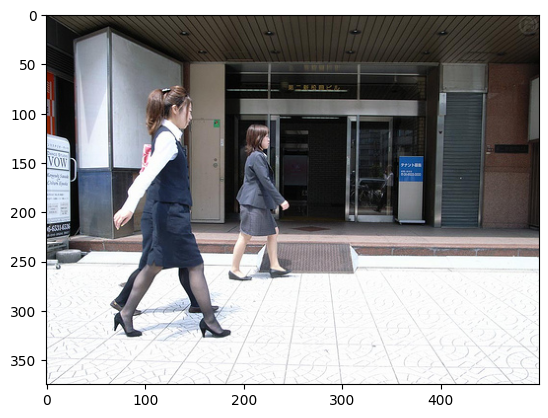

Three women in dress suits walk by a building .
a man in a black shirt and a black shirt and a woman walking down the street . <EOS>


/tmp/ipykernel_34/2759028504.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(test_df_out.iloc[data_idx][1])
/tmp/ipykernel_34/2759028504.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(test_df_out.iloc[data_idx][2])


In [37]:
data_idx = 2

image_path = "/kaggle/input/flickr8k/Images/"+test_df_out.iloc[data_idx][0]
img=mpimg.imread(image_path)
plt.imshow(img)
plt.show()
print(test_df_out.iloc[data_idx][1])
print(test_df_out.iloc[data_idx][2])

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


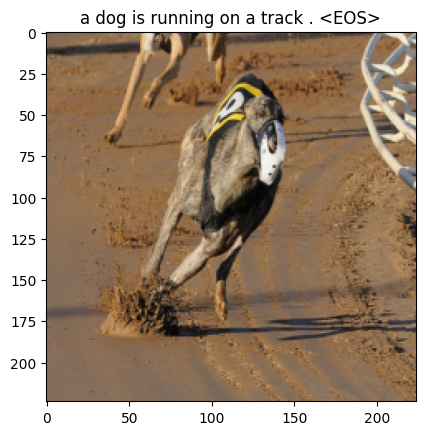

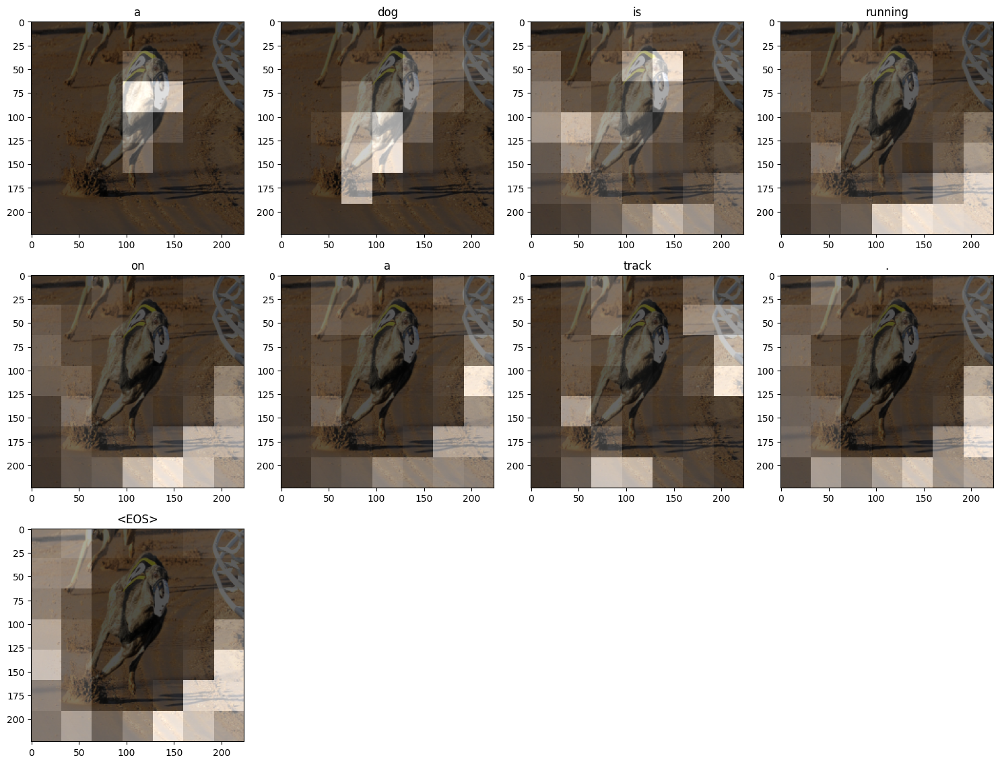

In [38]:
#generate caption
def get_caps_from(features_tensors):
    #generate the caption
    model.eval()
    with torch.no_grad():
        features = model.encoder(features_tensors.to(device))
        caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
        caption = ' '.join(caps)
        show_image(features_tensors[0],title=caption)
    
    return caps,alphas

def plot_attention(img, result, attention_plot):
    # Increase brightness of the original image
    img = img.numpy().transpose((1, 2, 0))
    img_brightness_adjusted = np.clip(img * 1.5, 0, 1)  # Increase brightness by scaling pixel values

    fig = plt.figure(figsize=(15, 15))

    len_result = len(result)
    for l in range(len_result):
        temp_att = attention_plot[l].reshape(7, 7)
        
        ax = fig.add_subplot(len_result // 2, len_result // 2, l + 1)
        ax.set_title(result[l])
        img = ax.imshow(img_brightness_adjusted)
        ax.imshow(temp_att, cmap='gray', alpha=0.7, extent=img.get_extent())
        
    plt.tight_layout()
    plt.show()


dataiter = iter(test_loader)
images,_ = next(dataiter)
img = images[6].detach().clone()
img1 = images[6].detach().clone()
caps,alphas = get_caps_from(img.unsqueeze(0))
plot_attention(img1, caps, alphas)

In [39]:
!pip install git+https://github.com/openai/CLIP.git

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-l49cqga9
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-l49cqga9
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 778.8 kB/s eta 0:00:00a 0:00:01
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369497 sha256=79649ba8dd68f1add6644cdb03121661486bc52af84a35210a71c2b346409d1a
  Stored in directory: /tmp/pip-ephem-wheel-cache-_pr0keiv/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip


In [40]:
import torch
import clip
import pandas as pd
import numpy as np
device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_preprocess = clip.load("ViT-B/32", device=device)
print(device)

100%|████████████████████████████████████████| 338M/338M [00:02<00:00, 141MiB/s]


cuda


In [41]:
def get_clip_embeddings(texts):
    with torch.no_grad():
        text_features = clip_model.encode_text(clip.tokenize(texts).to(device))
    return text_features.cpu().numpy()


caption_embeddings = get_clip_embeddings(test_df_out['caption'])
generated_caption_embeddings = get_clip_embeddings(test_df_out['Generated Caption'])

similarities = []
for i in range(len(test_df_out)):
    similarity = np.dot(caption_embeddings[i], generated_caption_embeddings[i]) / (
        np.linalg.norm(caption_embeddings[i]) * np.linalg.norm(generated_caption_embeddings[i])
    )
    similarities.append(similarity)

test_df_out['Similarity Score'] = similarities

test_df_out

,image,caption,Generated Caption,Similarity Score
0,3136674757_57406c305c.jpg,An older man in a tank top and a younger girl ...,a man with a blue shirt and a woman in a blue ...,0.384277
1,3187492926_8aa85f80c6.jpg,A person is diving into clear blue water .,a man in a black wetsuit is surfing . <EOS>,0.671875
2,3580741947_cc64a83648.jpg,Three women in dress suits walk by a building .,a man in a black shirt and a black shirt and a...,0.545410
3,2991994607_06f24ec7a6.jpg,Man in a police costume next to a man in a zom...,a man in a red jacket and a red hat and a red ...,0.618652
4,3273091032_98f724b36b.jpg,The squirrel sits straight up in the grass .,a dog is running in the grass . <EOS>,0.716797
...,...,...,...,...
4041,3468130925_2b1489d19a.jpg,Two men are playing rugby .,a rugby player in a red jersey is running in t...,0.808105
4042,3091962081_194f2f3bd4.jpg,A salt-and-pepper-haired man with beard and gl...,a man in a black jacket is holding a newspaper...,0.306885
4043,1752454466_723790dbd6.jpg,A brown and white dog is running down a ramp .,a dog is jumping over a hurdle . <EOS>,0.580078
4044,2057305043_952b8dc82c.jpg,Someone with a purple parachute has jumped off...,a person is flying through the water . <EOS>,0.682617


In [42]:
test_df_out.to_csv('/kaggle/working/test_df_out.csv')

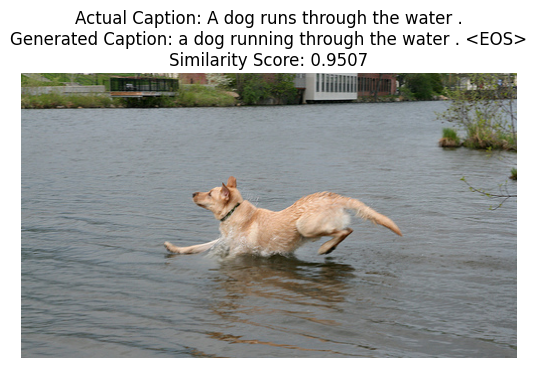

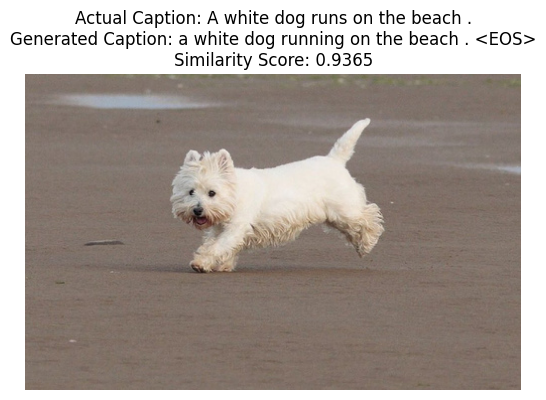

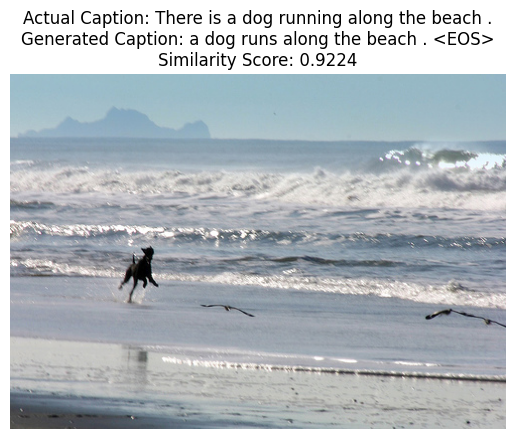

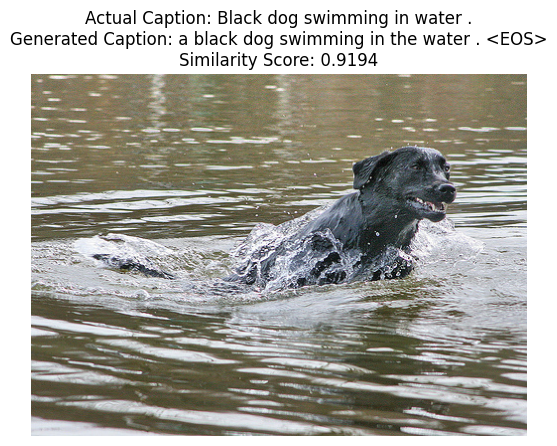

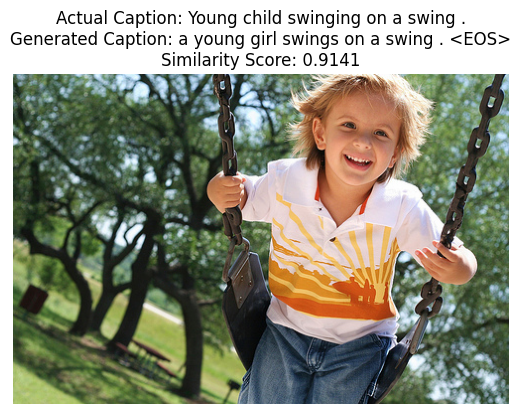

In [43]:
sorted_df = test_df_out.sort_values(by='Similarity Score', ascending=False)

top_5 = sorted_df.head(5)

def display_5(top_5):
    for idx, row in top_5.iterrows():
        actual_caption = row['caption']
        generated_caption = row['Generated Caption']
        similarity_score = row['Similarity Score']
        image_path = "/kaggle/input/flickr8k/Images/"+row['image']

        image = Image.open(image_path)
        plt.imshow(image)
        plt.title(f'Actual Caption: {actual_caption}\nGenerated Caption: {generated_caption}\nSimilarity Score: {similarity_score:.4f}')
        plt.axis('off')
        plt.show()

display_5(top_5)

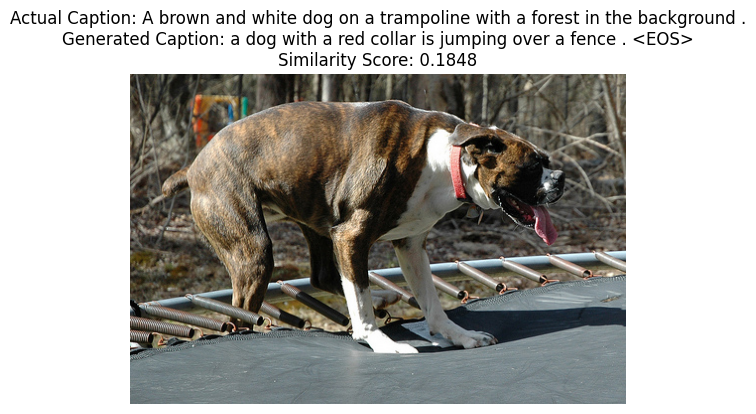

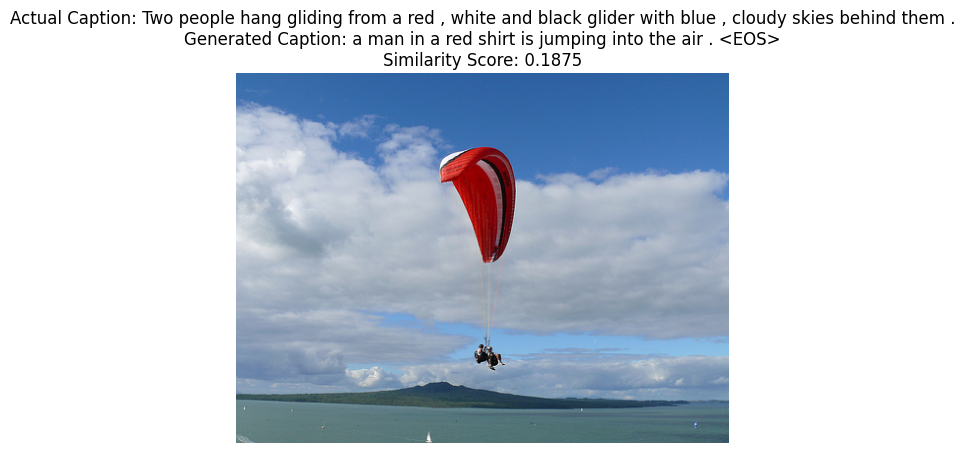

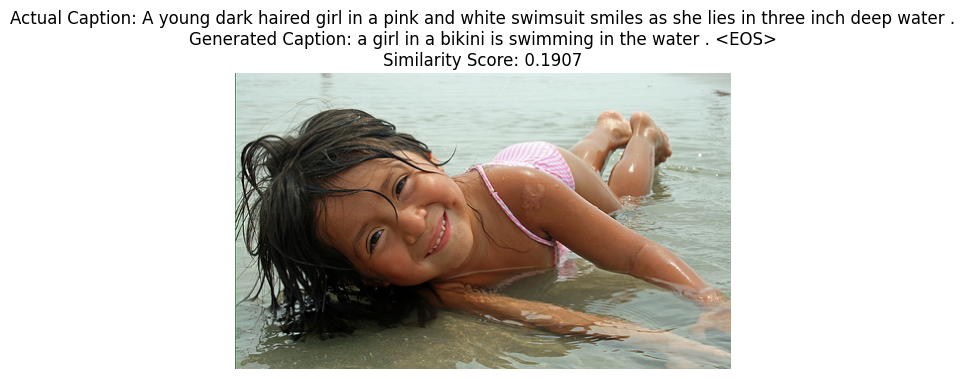

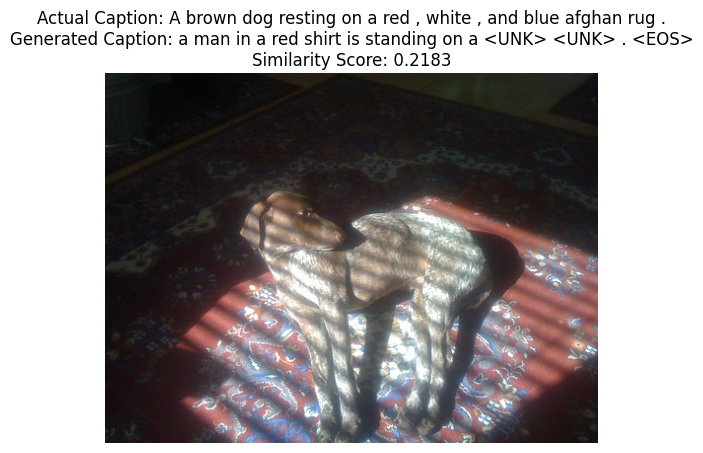

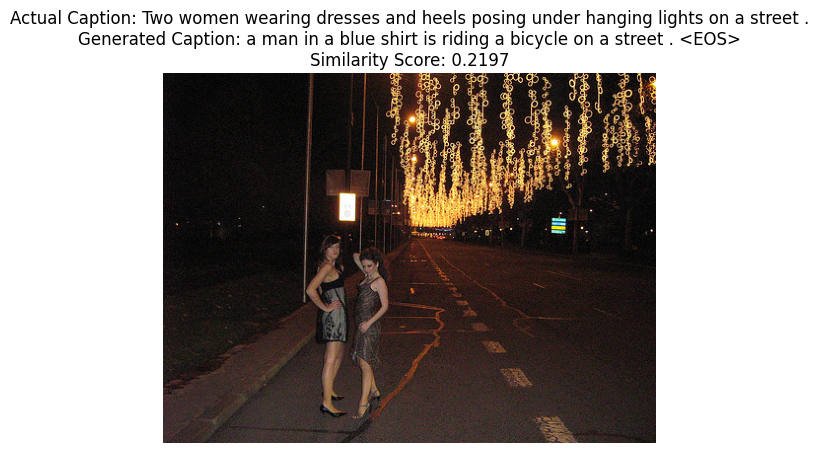

In [44]:
sorted_df_des= test_df_out.sort_values(by='Similarity Score', ascending=True)

# Get the bottom 5 rows
bottom_5 = sorted_df_des.head(5)
display_5(bottom_5)


In [45]:
def save_model(model, num_epochs):
    model_state = {
        'num_epochs': num_epochs,
        'embed_size': embed_size,
        'vocab_size': len(dataset.vocab),
        'attention_dim': attention_dim,
        'encoder_dim': encoder_dim,
        'decoder_dim': decoder_dim,
        'state_dict': model.state_dict()
    }
    torch.save(model_state, 'attention_model_state.pth')

def save_output_dataframe(df, filename):
    save_model(model, num_epochs)
    save_output_dataframe(test_df_out, 'generated_captions_output.csv')

In [46]:
test_df

,image,caption
0,3136674757_57406c305c.jpg,An older man in a tank top and a younger girl ...
1,3187492926_8aa85f80c6.jpg,A person is diving into clear blue water .
2,3580741947_cc64a83648.jpg,Three women in dress suits walk by a building .
3,2991994607_06f24ec7a6.jpg,Man in a police costume next to a man in a zom...
4,3273091032_98f724b36b.jpg,The squirrel sits straight up in the grass .
...,...,...
4041,3468130925_2b1489d19a.jpg,Two men are playing rugby .
4042,3091962081_194f2f3bd4.jpg,A salt-and-pepper-haired man with beard and gl...
4043,1752454466_723790dbd6.jpg,A brown and white dog is running down a ramp .
4044,2057305043_952b8dc82c.jpg,Someone with a purple parachute has jumped off...


In [47]:
test_df['image']

0       3136674757_57406c305c.jpg
1       3187492926_8aa85f80c6.jpg
2       3580741947_cc64a83648.jpg
3       2991994607_06f24ec7a6.jpg
4       3273091032_98f724b36b.jpg
                  ...            
4041    3468130925_2b1489d19a.jpg
4042    3091962081_194f2f3bd4.jpg
4043    1752454466_723790dbd6.jpg
4044    2057305043_952b8dc82c.jpg
4045    3111402233_6285bcba7a.jpg
Name: image, Length: 4046, dtype: object

In [48]:
from transformers import VisionEncoderDecoderModel, ViTFeatureExtractor, AutoTokenizer
import torch
from PIL import Image

# Load the pretrained model and tokenizer
model_2 = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
feature_extractor = ViTFeatureExtractor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
tokenizer = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

# Specify the device (GPU or CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_2.to(device)

# Define the maximum length for the generated caption
max_length = 100

# Function to generate captions
def generate_caption(image_path):
    # Open the image
    image = Image.open(image_path)

    # Prepare the image and input for the model
    pixel_values = feature_extractor(images=image, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to(device)

    # Generate the caption ids
    output_ids = model_2.generate(pixel_values, max_length=max_length, num_beams=4, early_stopping=True)

    # Decode the caption ids to text
    preds = tokenizer.decode(output_ids[0], skip_special_tokens=True)

    return preds

# Example usage
image_path = "/kaggle/input/flickr8k/Images/1000268201_693b08cb0e.jpg"
caption = generate_caption(image_path)
print(f"Generated caption: {caption}")

config.json:   0%|          | 0.00/4.61k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/982M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/228 [00:00<?, ?B/s]

/opt/conda/lib/python3.10/site-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/241 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/120 [00:00<?, ?B/s]

We strongly recommend passing in an `attention_mask` since your input_ids may be padded. See https://huggingface.co/docs/transformers/troubleshooting#incorrect-output-when-padding-tokens-arent-masked.
You may ignore this warning if your `pad_token_id` (50256) is identical to the `bos_token_id` (50256), `eos_token_id` (50256), or the `sep_token_id` (None), and your input is not padded.


Generated caption: a little girl standing next to a wooden bench 


In [49]:
import os
from transformers import VisionEncoderDecoderModel, ViTFeatureExtractor, AutoTokenizer
import torch
from PIL import Image
import pandas as pd

# Load the pretrained model and tokenizer
model_2 = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
feature_extractor = ViTFeatureExtractor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
tokenizer = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

# Specify the device (GPU or CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_2.to(device)

# Define the maximum length for the generated caption
max_length = 100

# Function to generate captions
def generate_caption(image_path):
    # Open the image
    image = Image.open(image_path)

    # Prepare the image and input for the model
    pixel_values = feature_extractor(images=image, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to(device)

    # Generate the caption ids
    output_ids = model_2.generate(pixel_values, max_length=max_length, num_beams=4, early_stopping=True)

    # Decode the caption ids to text
    preds = tokenizer.decode(output_ids[0], skip_special_tokens=True)

    return preds

# Path to the folder containing images
image_folder = "/kaggle/input/flickr8k/Images"

test_df['generated_caption'] = ''

for index, row in test_df.iterrows():
    image_path = os.path.join(image_folder, row['image'])
    caption = generate_caption(image_path)
    test_df.at[index, 'generated_caption'] = caption

print(test_df)

/tmp/ipykernel_34/2885661562.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df['generated_caption'] = ''


                          image  \
0     3136674757_57406c305c.jpg   
1     3187492926_8aa85f80c6.jpg   
2     3580741947_cc64a83648.jpg   
3     2991994607_06f24ec7a6.jpg   
4     3273091032_98f724b36b.jpg   
...                         ...   
4041  3468130925_2b1489d19a.jpg   
4042  3091962081_194f2f3bd4.jpg   
4043  1752454466_723790dbd6.jpg   
4044  2057305043_952b8dc82c.jpg   
4045  3111402233_6285bcba7a.jpg   

                                                caption  \
0     An older man in a tank top and a younger girl ...   
1            A person is diving into clear blue water .   
2       Three women in dress suits walk by a building .   
3     Man in a police costume next to a man in a zom...   
4          The squirrel sits straight up in the grass .   
...                                                 ...   
4041                        Two men are playing rugby .   
4042  A salt-and-pepper-haired man with beard and gl...   
4043     A brown and white dog is running down a

In [50]:
test_df.to_csv('generated_captions.csv', index=False)

In [51]:
test_df.to_csv('/kaggle/working/generated_captions.csv', index=False)

In [52]:
df_1=pd.read_csv('/kaggle/input/generated-captions-model2/generated_captions (1).csv')
df_1

,image,caption,generated_caption
0,3356901257_83811a19eb.jpg,A dog is jumping up for the ball while playing...,a dog jumping in the air to catch a frisbee
1,2902486045_6298eb22ef.jpg,Two dogs peeing on a fire hydrant .,a dog standing next to a fire hydrant
2,2843695880_eeea6c67db.jpg,Two boys stand in an ocean as the sun sets .,two people on a boat in the ocean
3,2672445419_251ce9419a.jpg,A young boy smiles as he hangs onto bars at th...,a young boy is posing for a picture
4,3097171315_0ba7d283b1.jpg,A group of people stand in a fancily decorated...,people in a room with a large mirror
...,...,...,...
4041,3425685827_03683e8e5a.jpg,People outside sitting on the grass under cher...,people sitting on a park bench
4042,2248487950_c62d0c81a9.jpg,A woman in a coat and a man in a tracksuit tal...,a man in a suit and a woman in a suit and tie
4043,109202756_b97fcdc62c.jpg,A woman rides a horse near a frozen lake in th...,a woman sitting on a horse next to a body of w...
4044,3523474077_16e14bc54c.jpg,a man holding a digital camera standing outsid...,a man standing in front of a building with a c...


In [53]:
test_df_out.to_csv('/kaggle/working/generated_captions-model1.csv', index=False)

In [54]:
df_2=pd.read_csv('/kaggle/input/test-df-out/test_df_out.csv')
# Drop the unnamed column from df_2
df_2.drop(columns=['Unnamed: 0'], inplace=True)
df_2

,image,caption,Generated Caption,Similarity Score
0,3275627207_0b41e44597.jpg,A man in a red shirt with dreadlocks is holdin...,a girl in a pink shirt is standing on a sidewa...,0.6050
1,241046599_28b0ca7b9f.jpg,"Brown dog , with green and purple cape , runs ...",a brown dog is playing with a toy in the grass...,0.5630
2,1296770308_3db2022f5a.jpg,There a several people in a dark bar-type room...,a man sitting on a stage . <EOS>,0.7324
3,396360611_941e5849a3.jpg,a man stands alone on the rocks .,a man is standing on rocks near a rocky shore ...,0.8190
4,1355833561_9c43073eda.jpg,A man in an orange jacket playfully tosses a s...,a man in a red shirt and a red shirt is standi...,0.4070
...,...,...,...,...
4041,209605542_ca9cc52e7b.jpg,a man with a red headband climbing a rock clif...,a man climbing a rock face . <EOS>,0.6360
4042,3322200641_c2e51ff37b.jpg,A dark dog jumps across the snow near the woods .,a black dog is running through snow . <EOS>,0.7940
4043,2467853482_17009933e8.jpg,A boy blowing bubbles .,a boy is blowing bubbles . <EOS>,0.9023
4044,2554531876_5d7f193992.jpg,A motorcycle rider making a turn .,a motorcycle rider is driving a turn on a race...,0.8180


In [55]:
df_3 = pd.concat([df_1, df_2], axis=1)
df_3 = df_3.loc[:, ~df_3.columns.duplicated()]

df_3.rename(columns={'Generated Caption': 'gen_cap_model'}, inplace=True)

df_3.rename(columns={'generated_caption': 'gen_cap_pretrained'}, inplace=True)
df_3.rename(columns={'Similarity Score': 'Similarity Score_model'}, inplace=True)
df_3

,image,caption,gen_cap_pretrained,gen_cap_model,Similarity Score_model
0,3356901257_83811a19eb.jpg,A dog is jumping up for the ball while playing...,a dog jumping in the air to catch a frisbee,a girl in a pink shirt is standing on a sidewa...,0.6050
1,2902486045_6298eb22ef.jpg,Two dogs peeing on a fire hydrant .,a dog standing next to a fire hydrant,a brown dog is playing with a toy in the grass...,0.5630
2,2843695880_eeea6c67db.jpg,Two boys stand in an ocean as the sun sets .,two people on a boat in the ocean,a man sitting on a stage . <EOS>,0.7324
3,2672445419_251ce9419a.jpg,A young boy smiles as he hangs onto bars at th...,a young boy is posing for a picture,a man is standing on rocks near a rocky shore ...,0.8190
4,3097171315_0ba7d283b1.jpg,A group of people stand in a fancily decorated...,people in a room with a large mirror,a man in a red shirt and a red shirt is standi...,0.4070
...,...,...,...,...,...
4041,3425685827_03683e8e5a.jpg,People outside sitting on the grass under cher...,people sitting on a park bench,a man climbing a rock face . <EOS>,0.6360
4042,2248487950_c62d0c81a9.jpg,A woman in a coat and a man in a tracksuit tal...,a man in a suit and a woman in a suit and tie,a black dog is running through snow . <EOS>,0.7940
4043,109202756_b97fcdc62c.jpg,A woman rides a horse near a frozen lake in th...,a woman sitting on a horse next to a body of w...,a boy is blowing bubbles . <EOS>,0.9023
4044,3523474077_16e14bc54c.jpg,a man holding a digital camera standing outsid...,a man standing in front of a building with a c...,a motorcycle rider is driving a turn on a race...,0.8180


In [56]:
caption_embeddings_2 = get_clip_embeddings(df_3['caption'])
generated_caption_embeddings_2 = get_clip_embeddings(df_3['gen_cap_pretrained'])

similarities = []
for i in range(len(df_3)):
    similarity = np.dot(caption_embeddings_2[i], generated_caption_embeddings_2[i]) / (
        np.linalg.norm(caption_embeddings_2[i]) * np.linalg.norm(generated_caption_embeddings_2[i])
    )
    similarities.append(similarity)

df_3['Similarity_Score_pretrained'] = similarities

df_3

,image,caption,gen_cap_pretrained,gen_cap_model,Similarity Score_model,Similarity_Score_pretrained
0,3356901257_83811a19eb.jpg,A dog is jumping up for the ball while playing...,a dog jumping in the air to catch a frisbee,a girl in a pink shirt is standing on a sidewa...,0.6050,0.817871
1,2902486045_6298eb22ef.jpg,Two dogs peeing on a fire hydrant .,a dog standing next to a fire hydrant,a brown dog is playing with a toy in the grass...,0.5630,0.850098
2,2843695880_eeea6c67db.jpg,Two boys stand in an ocean as the sun sets .,two people on a boat in the ocean,a man sitting on a stage . <EOS>,0.7324,0.686523
3,2672445419_251ce9419a.jpg,A young boy smiles as he hangs onto bars at th...,a young boy is posing for a picture,a man is standing on rocks near a rocky shore ...,0.8190,0.674805
4,3097171315_0ba7d283b1.jpg,A group of people stand in a fancily decorated...,people in a room with a large mirror,a man in a red shirt and a red shirt is standi...,0.4070,0.726074
...,...,...,...,...,...,...
4041,3425685827_03683e8e5a.jpg,People outside sitting on the grass under cher...,people sitting on a park bench,a man climbing a rock face . <EOS>,0.6360,0.734375
4042,2248487950_c62d0c81a9.jpg,A woman in a coat and a man in a tracksuit tal...,a man in a suit and a woman in a suit and tie,a black dog is running through snow . <EOS>,0.7940,0.659180
4043,109202756_b97fcdc62c.jpg,A woman rides a horse near a frozen lake in th...,a woman sitting on a horse next to a body of w...,a boy is blowing bubbles . <EOS>,0.9023,0.728027
4044,3523474077_16e14bc54c.jpg,a man holding a digital camera standing outsid...,a man standing in front of a building with a c...,a motorcycle rider is driving a turn on a race...,0.8180,0.892578


In [57]:
df_3.to_csv('/kaggle/working/final_test_df.csv', index=False)

In [58]:
df_3=pd.read_csv('/kaggle/input/final-test-df/final_test_df.csv')

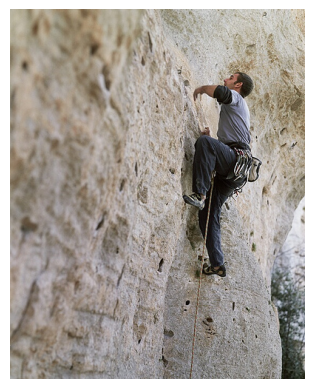

Actual Caption: A man is climbing a rock wall .
Generated Caption (Model): a man climbing a rock wall . <EOS>
Generated Caption (Pretrained): a man sitting on top of a rock wall 
Similarity Score (Model): 0.958




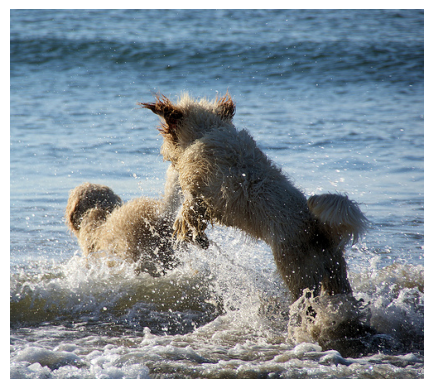

Actual Caption: Two dogs playing in the water , one is bounding at the other .
Generated Caption (Model): two dogs playing in the water . <EOS>
Generated Caption (Pretrained): a dog running through the water with its tongue out 
Similarity Score (Model): 0.943




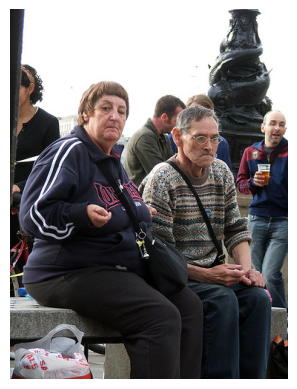

Actual Caption: A man and a woman sitting on a bench
Generated Caption (Model): a man and woman sitting on a bench . <EOS>
Generated Caption (Pretrained): a woman sitting on a bench next to a group of people 
Similarity Score (Model): 0.941




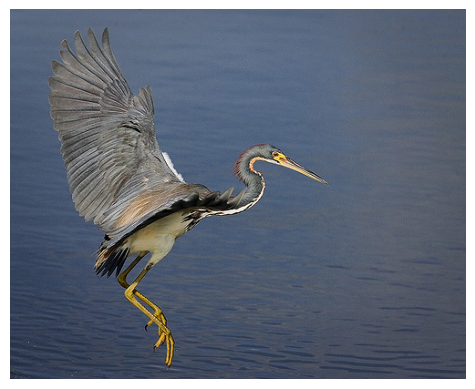

Actual Caption: A large bird is flying over water .
Generated Caption (Model): a large bird flying through the water . <EOS>
Generated Caption (Pretrained): a bird standing on top of a body of water 
Similarity Score (Model): 0.939




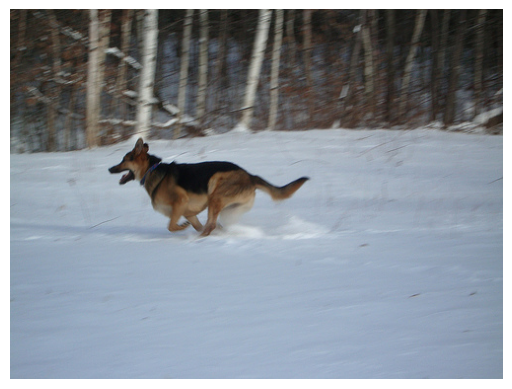

Actual Caption: The dog runs through the snow .
Generated Caption (Model): a dog runs through the snow . <EOS>
Generated Caption (Pretrained): a dog running across a snow covered slope 
Similarity Score (Model): 0.9355




In [59]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

images_folder_path = "/kaggle/input/flickr8k/Images"

sorted_df = df_3.sort_values(by='Similarity Score_model', ascending=False)

image_filenames = os.listdir(images_folder_path)

num_images_to_display = 5

for index, row in sorted_df.head(num_images_to_display).iterrows():

    image_path = os.path.join(images_folder_path, row['image'])

    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')
    plt.show()

    print("Actual Caption:", row['caption'])
    print("Generated Caption (Model):", row['gen_cap_model'])
    print("Generated Caption (Pretrained):", row['gen_cap_pretrained'])
    print("Similarity Score (Model):", row['Similarity Score_model'])
    print("\n")

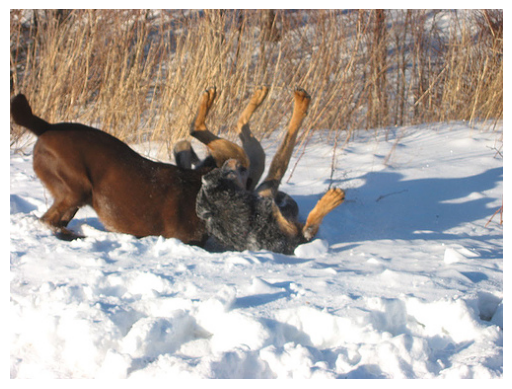

Actual Caption: Two dogs playing in the snow .
Generated Caption (Model): a brown dog is jumping over a snow covered in snow . <EOS>
Generated Caption (Pretrained): two dogs playing with each other in the snow 
Similarity Score (Model): 0.9785




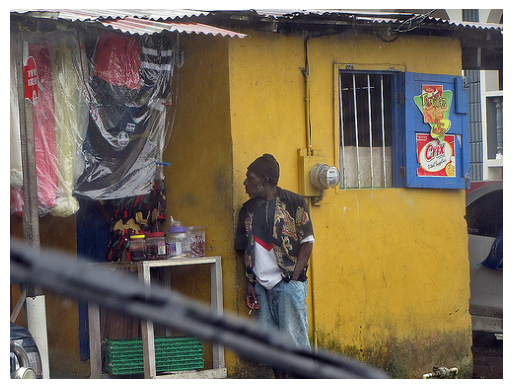

Actual Caption: A man is standing outside of a yellow building .
Generated Caption (Model): a man in a yellow shirt is standing on a yellow rail . <EOS>
Generated Caption (Pretrained): a man standing in front of a yellow building 
Similarity Score (Model): 0.9727




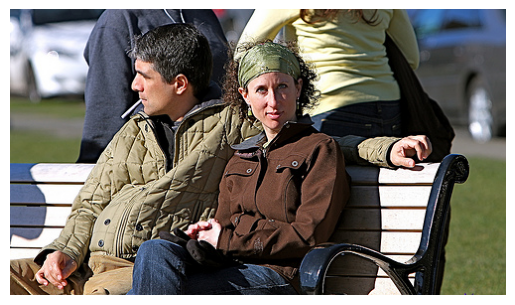

Actual Caption: A man and a woman on a bench .
Generated Caption (Model): a man in a black coat and a hat sits on a bench . <EOS>
Generated Caption (Pretrained): a man and a woman sitting on a bench 
Similarity Score (Model): 0.9683




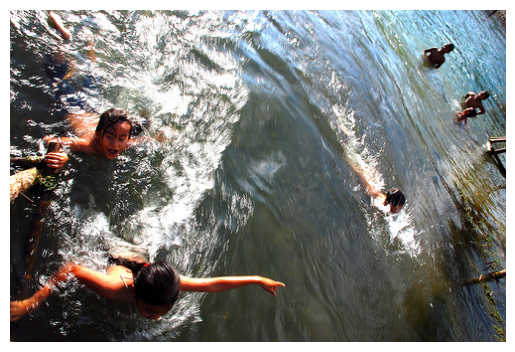

Actual Caption: A bunch of people swimming in water .
Generated Caption (Model): a man is climbing a rock face . <EOS>
Generated Caption (Pretrained): people swimming in a body of water 
Similarity Score (Model): 0.9683




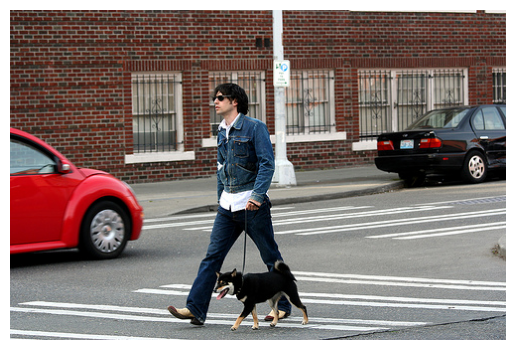

Actual Caption: a man walks his dog in the street .
Generated Caption (Model): a man in a black coat and black pants and a black dog walks down the street . <EOS>
Generated Caption (Pretrained): a man walking a dog on a city street 
Similarity Score (Model): 0.9663




In [60]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

images_folder_path = "/kaggle/input/flickr8k/Images"

sorted_df = df_3.sort_values(by='Similarity_Score_pretrained', ascending=False)

image_filenames = os.listdir(images_folder_path)

num_images_to_display = 5

for index, row in sorted_df.head(num_images_to_display).iterrows():
    image_path = os.path.join(images_folder_path, row['image'])

    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')
    plt.show()

    print("Actual Caption:", row['caption'])
    print("Generated Caption (Model):", row['gen_cap_model'])
    print("Generated Caption (Pretrained):", row['gen_cap_pretrained'])
    print("Similarity Score (Model):", row['Similarity_Score_pretrained'])
    print("\n")

In [61]:
final_test_df=pd.read_csv('/kaggle/input/final-test-df/final_test_df.csv')

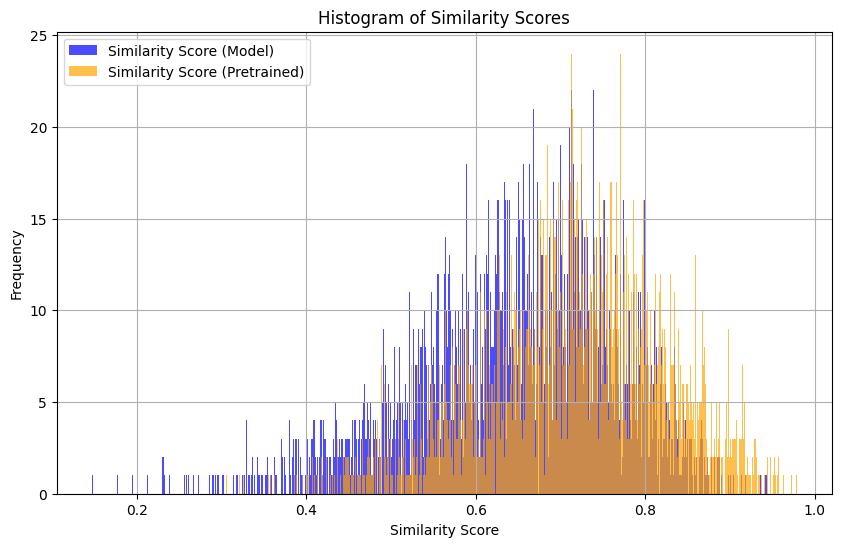

In [62]:
plt.figure(figsize=(10, 6))

# Plot histogram for Similarity Score_model
plt.hist(final_test_df['Similarity Score_model'], bins=1000, color='blue', alpha=0.7, label='Similarity Score (Model)')

# Plot histogram for Similarity_Score_pretrained
plt.hist(final_test_df['Similarity_Score_pretrained'], bins=1000, color='orange', alpha=0.7, label='Similarity Score (Pretrained)')

plt.xlabel('Similarity Score')
plt.ylabel('Frequency')
plt.title('Histogram of Similarity Scores')
plt.legend()
plt.grid(True)
plt.show()

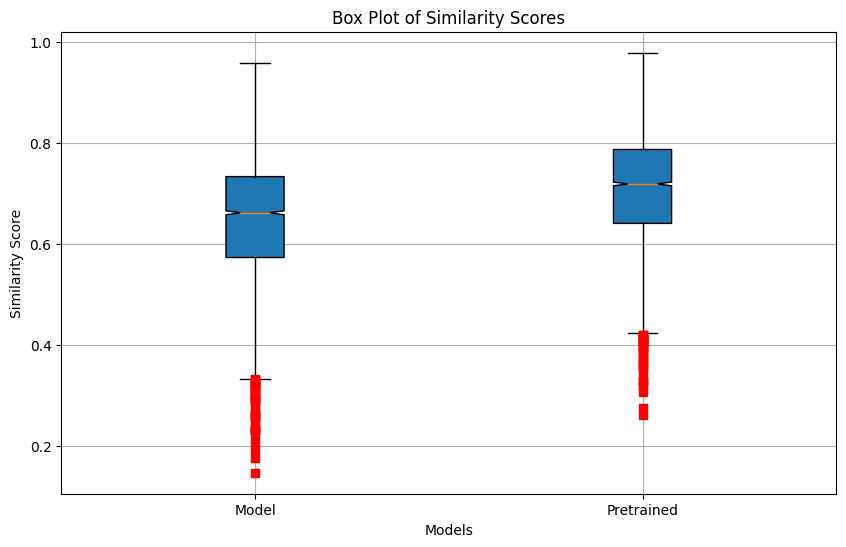

In [63]:
plt.figure(figsize=(10, 6))

# Create a box plot for both models
plt.boxplot([final_test_df['Similarity Score_model'], final_test_df['Similarity_Score_pretrained']],
            labels=['Model', 'Pretrained'],
            notch=True, patch_artist=True, sym='rs')

plt.xlabel('Models')
plt.ylabel('Similarity Score')
plt.title('Box Plot of Similarity Scores')
plt.grid(True)
plt.show()

In [64]:
!pip install nltk
import nltk
from nltk.translate.bleu_score import sentence_bleu

def bleu_score(hypothesis, reference):
    # Tokenize
    hypothesis = hypothesis.split()
    reference = reference.split()

    # Calculate BLEU score
    smoothing_function = nltk.translate.bleu_score.SmoothingFunction().method1
    bleu = sentence_bleu([reference], hypothesis, smoothing_function=smoothing_function)
    return bleu

# Calculate scores and add them as new columns
final_test_df['BLEU_score_model'] = final_test_df.apply(lambda x: bleu_score(x['gen_cap_model'], x['caption']), axis=1)

final_test_df['BLEU_score_pretrained'] = final_test_df.apply(lambda x: bleu_score(x['gen_cap_pretrained'], x['caption']), axis=1)

final_test_df

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


,image,caption,gen_cap_pretrained,gen_cap_model,Similarity Score_model,Similarity_Score_pretrained,BLEU_score_model,BLEU_score_pretrained
0,3356901257_83811a19eb.jpg,A dog is jumping up for the ball while playing...,a dog jumping in the air to catch a frisbee,a man is playing with a dog in a field . <EOS>,0.5920,0.8180,0.019836,0.034040
1,2902486045_6298eb22ef.jpg,Two dogs peeing on a fire hydrant .,a dog standing next to a fire hydrant,two dogs are running on a sidewalk . <EOS>,0.6730,0.8500,0.060307,0.137471
2,2843695880_eeea6c67db.jpg,Two boys stand in an ocean as the sun sets .,two people on a boat in the ocean,a man is walking on the water with a sunset in...,0.6313,0.6865,0.017396,0.025124
3,2672445419_251ce9419a.jpg,A young boy smiles as he hangs onto bars at th...,a young boy is posing for a picture,a little boy in a blue shirt is holding a baby...,0.5810,0.6750,0.028788,0.031441
4,3097171315_0ba7d283b1.jpg,A group of people stand in a fancily decorated...,people in a room with a large mirror,a man in a black shirt and a white shirt is st...,0.6616,0.7260,0.024218,0.048010
...,...,...,...,...,...,...,...,...
4041,3425685827_03683e8e5a.jpg,People outside sitting on the grass under cher...,people sitting on a park bench,a group of people are standing in a tree . <EOS>,0.6055,0.7344,0.018850,0.037521
4042,2248487950_c62d0c81a9.jpg,A woman in a coat and a man in a tracksuit tal...,a man in a suit and a woman in a suit and tie,a man in a black jacket is sitting on a sidewa...,0.5480,0.6590,0.150652,0.196474
4043,109202756_b97fcdc62c.jpg,A woman rides a horse near a frozen lake in th...,a woman sitting on a horse next to a body of w...,a woman in a brown jacket is walking on a brow...,0.4590,0.7280,0.021359,0.039411
4044,3523474077_16e14bc54c.jpg,a man holding a digital camera standing outsid...,a man standing in front of a building with a c...,a man in a blue shirt and a woman in a white s...,0.4646,0.8926,0.024218,0.053906


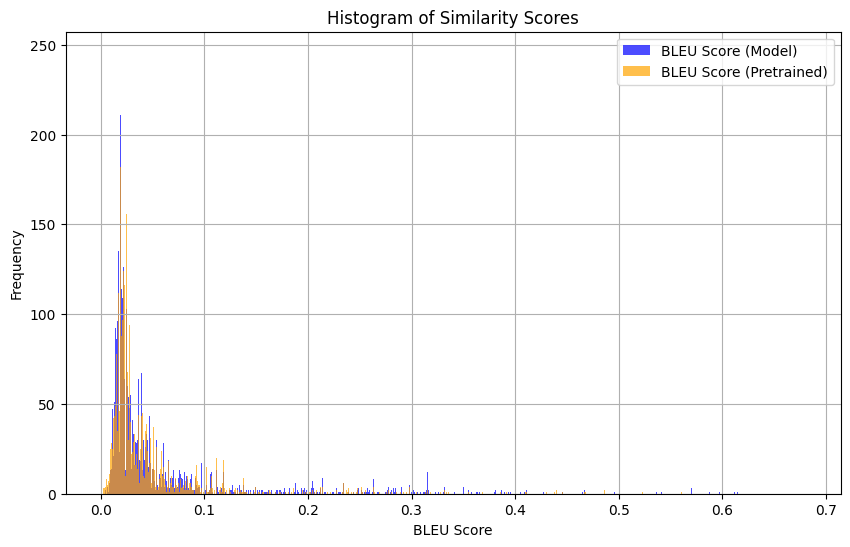

In [65]:
plt.figure(figsize=(10, 6))

# Plot histogram for Similarity Score_model
plt.hist(final_test_df['BLEU_score_model'], bins=1000, color='blue', alpha=0.7, label='BLEU Score (Model)')

# Plot histogram for Similarity_Score_pretrained
plt.hist(final_test_df['BLEU_score_pretrained'], bins=1000, color='orange', alpha=0.7, label='BLEU Score (Pretrained)')

plt.xlabel('BLEU Score')
plt.ylabel('Frequency')
plt.title('Histogram of Similarity Scores')
plt.legend()
plt.grid(True)
plt.show()